In [1]:
import os
import sys
one_level_up_dir = os.path.abspath(os.path.join(os.getcwd(), "../../"))
sys.path.append(one_level_up_dir)
import jax._src.random as prng
import jax
from jax import config, jit
import jax.numpy as jnp
import jax.random as jr
import diffrax as dfx
import matplotlib.pyplot as plt
import optax as ox
import equinox as eqx
from ppc.systems.nonlinear_dynamics import VanDerPol
from ppc.control.trajectory_optimizers import *
from ppc.control.cost_functions import QuadraticCost
from ppc.nn.node import NeuralODE, EnsembleNeuralODE
from ppc.nn.nnvectorfield import NeuralVectorField, EnsembleNeuralVectorField
from ppc.fit import *
config.update("jax_enable_x64", True)
config.update("jax_debug_nans", True)
PRNGKey = prng.KeyArray
key = jr.PRNGKey(12314) 
key, subkey = jr.split(key)
%load_ext autoreload
%autoreload 2

In [2]:
from ppc.control.control_task import VanderPolStabilization
env = VanderPolStabilization()
env


VanderPolStabilization(
  real_system=VanDerPol(
    D_sys=2,
    D_control=1,
    solver=Dopri8(scan_kind=None),
    name='Van der Pol',
    control_interpolator='linear',
    mu=1.5
  ),
  D_sys=2,
  D_control=1,
  R=f64[1,1],
  Q=f64[2,2],
  x_star=f64[2],
  u_star=f64[1],
  y0=f64[2],
  t0=0.0,
  tf=10.0,
  Delta_t=0.05,
  measurement_noise_std=0.01,
  lb=-2.0,
  ub=2.0,
  state_cost=QuadraticCost(
    Q=f64[2,2],
    R=f64[1,1],
    x_star=f64[2],
    u_star=f64[1],
    transform=None
  ),
  termination_cost=QuadraticCost(
    Q=f64[2,2],
    R=f64[1,1],
    x_star=f64[2],
    u_star=f64[1],
    transform=None
  ),
  H=None,
  Q_f=f64[2,2],
  name='Van der Pol stabilization control task'
)

## data generation

In [3]:
## data generation
t0 = env.t0
tf = env.tf
dt = env.Delta_t
dt0_dense = 1e-2

num_trials = 25
num_obs = int((tf-t0)/dt)
D_in, D_out = env.D_sys+ env.D_control, env.D_sys
noise = jnp.array([jnp.sqrt(env.measurement_noise_std) for _ in range(D_out)]) # sigma^2 = 0.05 in Hegde experiment 4.1

## ode params
stepsize_controller=dfx.PIDController(rtol=1e-4, atol=1e-5, jump_ts=None)
internal_solver = dfx.Dopri5() 
dt0_internal = 2e-2

## neural network
ensemble_size = 5
data_per_ensemble = num_trials
hidden_dim = 32
layer_sizes = (D_in, hidden_dim, hidden_dim, D_out)
activation = jax.nn.elu

## training
num_iters = 2_000
init_obs_noise = 0.5
batch_size = -1 # -1 or num_trials for no batching
lr = 0.001
log_rate = 20

In [4]:
# initial state distribution
real_system = env.real_system
x0_distribution = lambda key: .1*(jr.uniform(key=key,minval=-1, maxval=1, shape=(2,)))
key, subkey = jr.split(key)

# randomly sample observation times. 
ts_uniform = jnp.concatenate([jnp.linspace(t0, tf, num_obs)[None] for _ in range(num_trials)], axis=0)
ts = jnp.sort(ts_uniform, axis=1)
ts_dense = jnp.concatenate([jnp.linspace(t0, tf, num_obs*3)[None] for _ in range(num_trials)], axis=0)
freqs = jnp.arange(1,num_trials+1)
indices = jnp.linspace(0.2, 1.5, num_trials)
us = jax.vmap(lambda t, i: 2*jnp.cos(5.5*jr.uniform(jr.PRNGKey(round(3**i)))*jnp.pi*t*i+jr.normal(jr.PRNGKey(round(2**i))))+
              1.5*jnp.cos(2.5*jr.uniform(jr.PRNGKey(round(4**i)))*jnp.pi*t*i+jr.normal(jr.PRNGKey(round(5**i)))), in_axes=(0,0))(ts_dense, indices)[..., None]

key, subkey = jr.split(key)


# simulate data from real system
key, subkey = jr.split(key)
data, true_y0s = env.real_system.generate_synthetic_data(subkey,
                                           num_trials,
                                           dt0=dt0_dense,
                                           ts=ts,
                                           us=us,
                                           obs_stddev=noise,
                                           ts_dense=ts_dense,
                                           x0_distribution=env.get_initial_condition,#x0_distribution,#
                                           standardize_at_initialisation=False,
                                          )

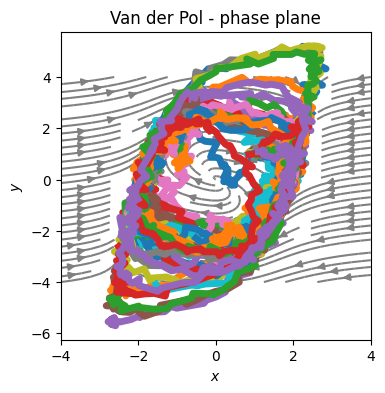

In [5]:
env.real_system.visualize_phaseplane(data=data, X_range=jnp.array([[-4., 4.],[-4., 4.]]))
plt.show()
# real_system.visualize_longitunidal(test_ts=ts, true_y0s=true_y0s, data=data)
# plt.show()

## Train neural ODE

In [7]:
keys = jr.split(subkey, ensemble_size)

ensemble_datasets = jax.vmap(get_batch, in_axes=(None, None, 0, None))(data, data_per_ensemble, keys, False)
key, subkey = jr.split(key)
ensemble_datasets.ys.shape

(5, 25, 200, 2)

In [8]:
from ppc.nn.nnvectorfield import EnsembleNeuralVectorField

ensemble_vectorfield = EnsembleNeuralVectorField(
                                ensemble_size=ensemble_size,
                                layer_sizes=layer_sizes,
                                activation=activation,
                                D_sys=real_system.D_sys,
                                D_control=real_system.D_control,
                                key=key,)

In [9]:
from ppc.nn.node import EnsembleNeuralODE
""" testing the neural ODE call with the newly created vectorfield class."""

# initialize p(x0)
x0_mean_init = ensemble_datasets.ys[:,:,0,:]
x0_diag_raw = jnp.zeros_like(x0_mean_init)-1.

ensemble_node = EnsembleNeuralODE(
                          ensemble_size=ensemble_size,
                          obs_noise_raw=jnp.log(jnp.exp(init_obs_noise)-1.),
                          x0_mean=x0_mean_init-1,
                          x0_diag_raw=x0_diag_raw,
                          vectorfield=ensemble_vectorfield,
                          solver=dfx.Dopri5(),
                          dt0=dt0_internal,
                          stepsize_controller=dfx.PIDController(rtol=1e-4,atol=1e-5),
                          D_sys=real_system.D_sys,
                          D_control=real_system.D_control,
                          )

In [10]:
ensemble_node

EnsembleNeuralODE(
  vectorfield=EnsembleNeuralVectorField(
    ensemble_size=5,
    layer_sizes=(3, 32, 32, 2),
    activation=<wrapped function elu>,
    final_activation=<function <lambda>>,
    D_sys=2,
    D_control=1,
    _name='Ensemble neural ODE',
    model=NeuralVectorField(
      layers=[
        Linear(
          weight=f64[5,32,3],
          bias=f64[5,32],
          in_features=3,
          out_features=32,
          use_bias=True
        ),
        Linear(
          weight=f64[5,32,32],
          bias=f64[5,32],
          in_features=32,
          out_features=32,
          use_bias=True
        ),
        Linear(
          weight=f64[5,2,32],
          bias=f64[5,2],
          in_features=32,
          out_features=2,
          use_bias=True
        )
      ],
      activation=<wrapped function elu>,
      final_activation=<function <lambda>>,
      D_sys=2,
      D_control=1,
      _name='Neural ODE'
    )
  ),
  solver=Dopri5(scan_kind=None),
  stepsize_controller=PID

100%|██████████| 2000/2000 [06:50<00:00,  4.87it/s, loss=0.0213]


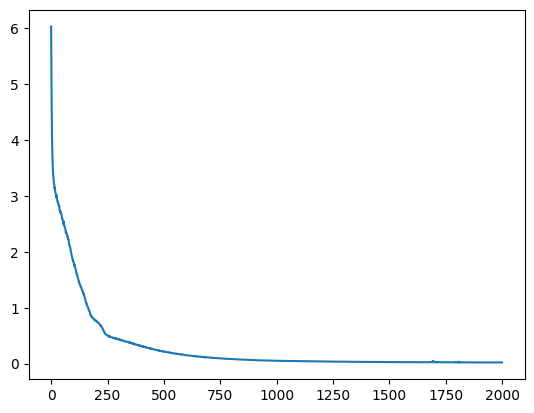

In [11]:
from gpdx.fit import fit_node
from gpdx.nn.node import mse_loss_ensemble

optim = ox.adam(learning_rate=lr)

opt_ensemble_node, history = fit_node(model=ensemble_node, 
         objective=mse_loss_ensemble, 
         train_data=ensemble_datasets, 
         optim = optim, 
         key=subkey,
         num_iters=num_iters,
         batch_size=batch_size,
         log_rate=log_rate,)
key, subkey = jr.split(key, 2)

plt.plot(history)
plt.show()

## MPC with learned model

In [12]:
from ppc.control.trajectory_optimizers import *
from ppc.control.mpc import ensembleDirectMPC

H = 3
n_controls = int(H/env.Delta_t)
maxiter=15
trial_ts = jnp.linspace(env.t0, env.tf, int( ((1/env.Delta_t))*(tf-t0)))#jnp.arange(env.t0, env.tf, env.Delta_t)

sqp_solver = SLSQP(
                lb=env.lb*jnp.ones((n_controls, env.D_control)),
                ub=env.ub*jnp.ones((n_controls, env.D_control)),
                maxiter=maxiter,)

# cem_solver = CEM(
#                 lb=env.lb*jnp.ones((n_controls, env.D_control)),
#                 ub=env.ub*jnp.ones((n_controls, env.D_control)),
#                 maxiter=maxiter,
#                 pop_size=500,
#                 elite_size=int(0.13*500),
#                 alpha=0.3,
#                 init_var=1)


ensemble_mpc = ensembleDirectMPC(
            traj_optimizer=sqp_solver,
            real_system=real_system,
            internal_system=opt_ensemble_node,
            state_cost=env.state_cost,
            termination_cost=env.termination_cost,
            verbose=True,
            )

Traj. opt. times:  [0.1228, 0.0771, 0.0778, 0.077, 0.0773, 0.0807, 0.0794, 0.0841, 0.0834, 0.0804]


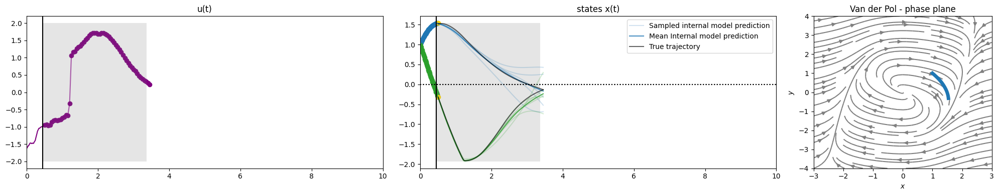

Traj. opt. times:  [0.0776, 0.0763, 0.0764, 0.0796, 0.0626, 0.0749, 0.0583, 0.0623, 0.0776, 0.0796]


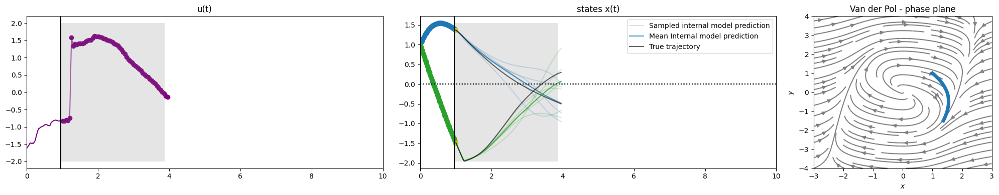

Traj. opt. times:  [0.0789, 0.0864, 0.0878, 0.0855, 0.081, 0.0806, 0.0786, 0.0798, 0.0806, 0.0805]


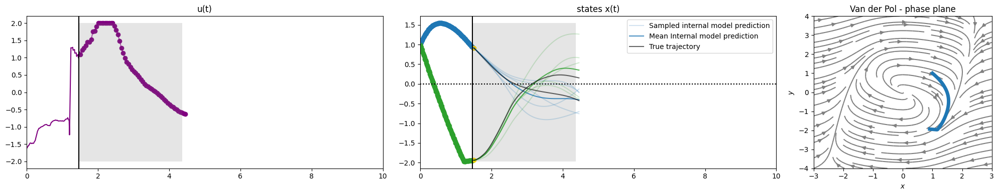

Traj. opt. times:  [0.0846, 0.0818, 0.0773, 0.077, 0.0784, 0.0766, 0.0805, 0.0772, 0.0772, 0.0796]


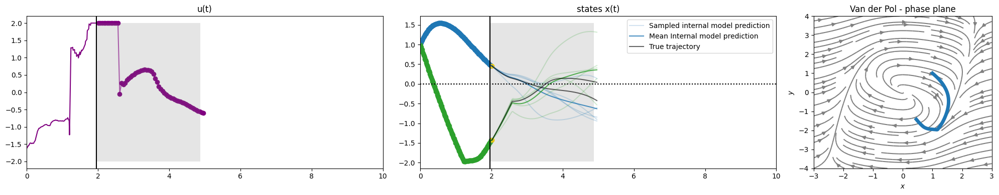

Traj. opt. times:  [0.0778, 0.0777, 0.0754, 0.0715, 0.0769, 0.0789, 0.078, 0.0799, 0.079, 0.079]


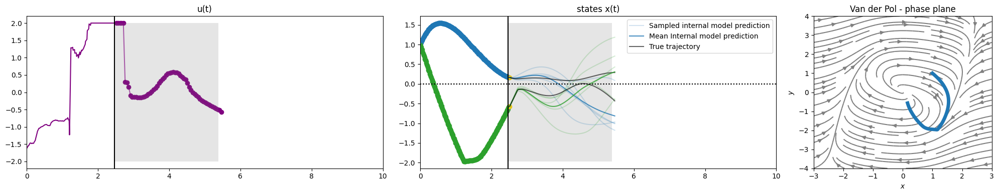

Traj. opt. times:  [0.0831, 0.092, 0.0892, 0.0907, 0.0847, 0.0937, 0.0979, 0.084, 0.0785, 0.0795]


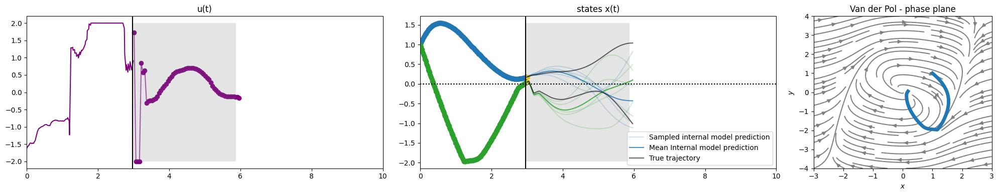

Traj. opt. times:  [0.0863, 0.085, 0.0999, 0.0891, 0.093, 0.0807, 0.0801, 0.0811, 0.0878, 0.0879]


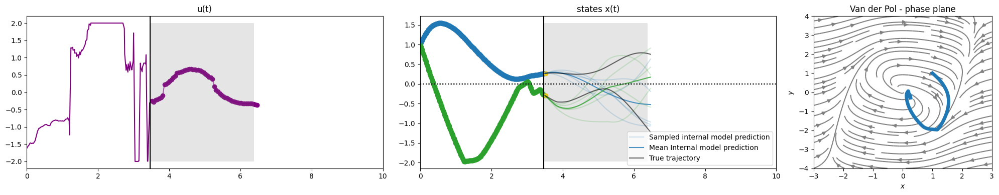

Traj. opt. times:  [0.085, 0.0853, 0.0872, 0.0874, 0.0868, 0.0877, 0.0891, 0.0798, 0.079, 0.0788]


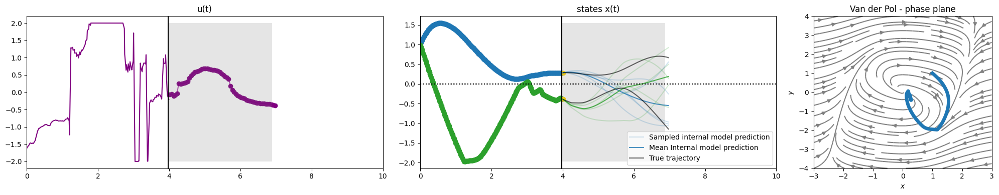

Traj. opt. times:  [0.0842, 0.0841, 0.0848, 0.0838, 0.0777, 0.0752, 0.0775, 0.0868, 0.0903, 0.0859]


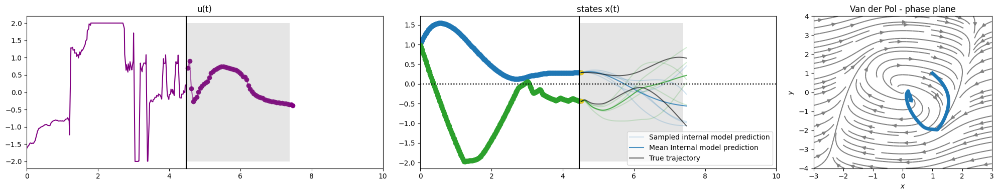

Traj. opt. times:  [0.0848, 0.085, 0.0787, 0.0765, 0.0869, 0.0909, 0.0868, 0.0791, 0.0772, 0.0806]


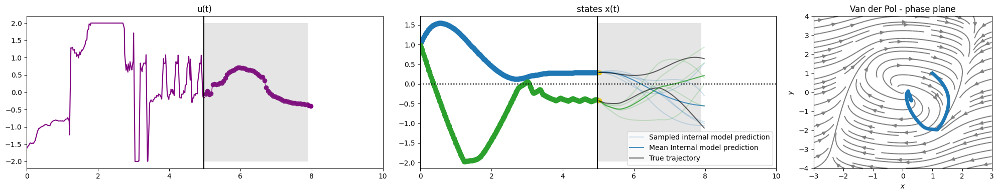

Traj. opt. times:  [0.0851, 0.0841, 0.0786, 0.0797, 0.0751, 0.0748, 0.0867, 0.0841, 0.0862, 0.0761]


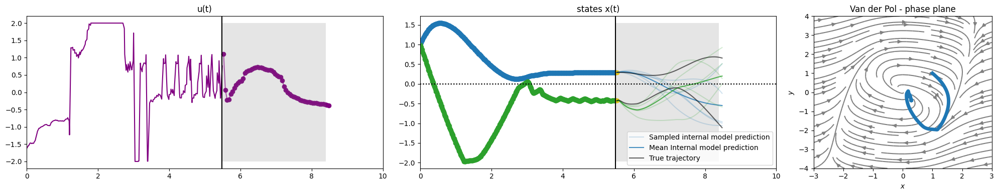

Traj. opt. times:  [0.0794, 0.075, 0.0885, 0.0865, 0.0763, 0.076, 0.0784, 0.0865, 0.0945, 0.0867]


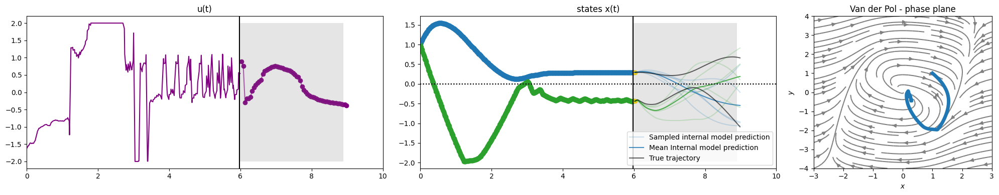

Traj. opt. times:  [0.0809, 0.0785, 0.0798, 0.0866, 0.0887, 0.0802, 0.0755, 0.0752, 0.075, 0.083]


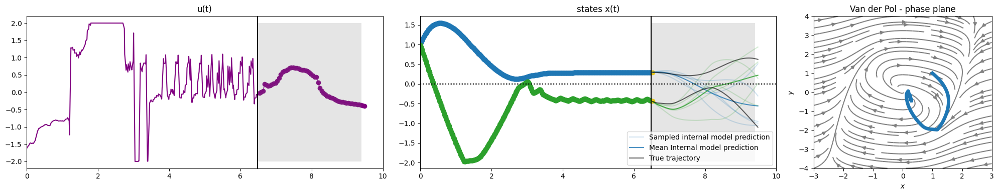

Traj. opt. times:  [0.0922, 0.0975, 0.0794, 0.0789, 0.0825, 0.0879, 0.0865, 0.0809, 0.0778, 0.0774]


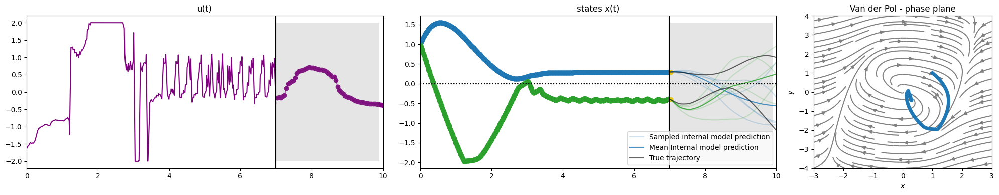

Traj. opt. times:  [0.0757, 0.0841, 0.0884, 0.084, 0.0742, 0.0753, 0.0749, 0.0824, 0.0831, 0.0803]


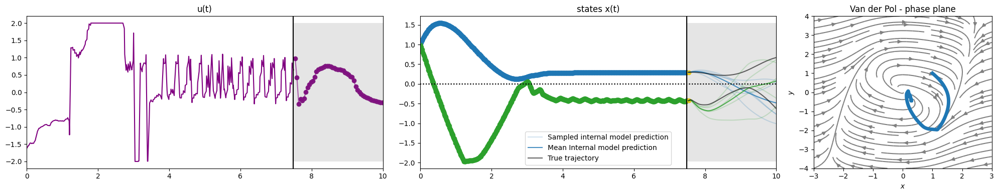

Traj. opt. times:  [0.0762, 0.0771, 0.0752, 0.0831, 0.0872, 0.0851, 0.0751, 0.0741, 0.0741, 0.0836]


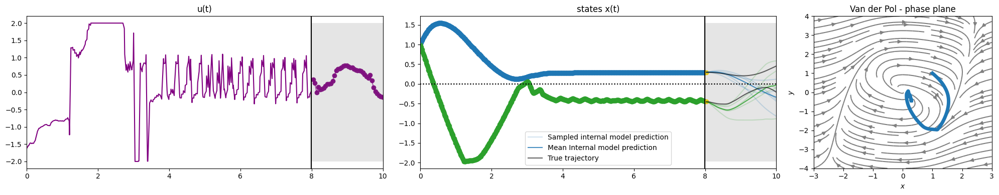

Traj. opt. times:  [0.0893, 0.0826, 0.0785, 0.0788, 0.0776, 0.0876, 0.0965, 0.0874, 0.079, 0.0777]


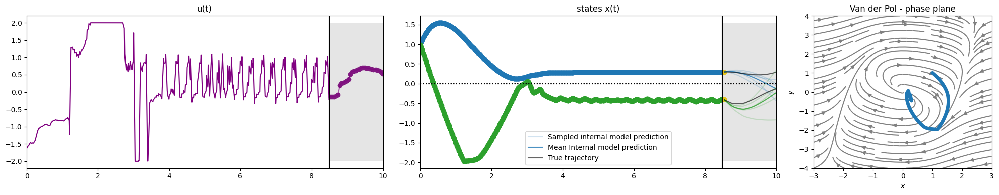

Traj. opt. times:  [0.0749, 0.0827, 0.0838, 0.0837, 0.0752, 0.074, 0.0761, 0.0831, 0.0873, 0.0803]


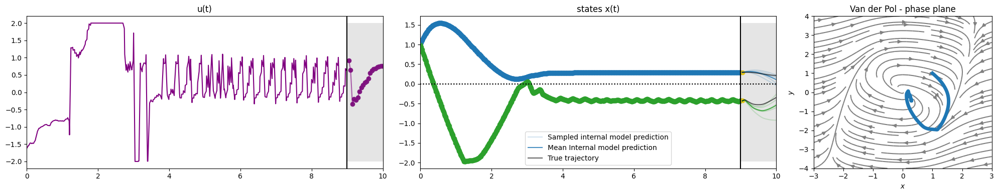

Traj. opt. times:  [0.0795, 0.0789, 0.0799, 0.0879, 0.0908, 0.0892, 0.0785, 0.0785, 0.0786, 0.0859]


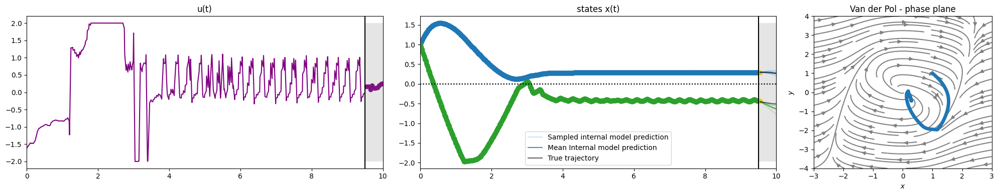

Traj. opt. times:  [0.0961, 0.0823, 0.0758, 0.0751, 0.075, 0.0885, 0.0916, 0.079, 0.0758, 0.0747]


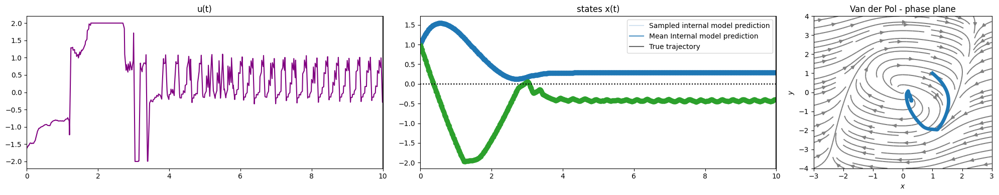

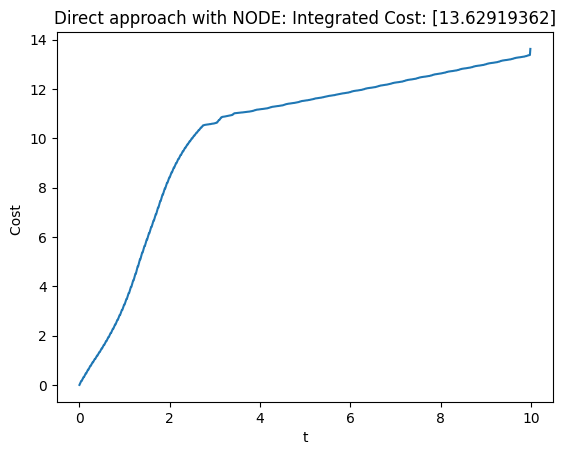

In [13]:
# run with ground truth as internal model
ts, ts_dense, X, ys, U, R = ensemble_mpc.simulate(
                        x0=env.get_initial_condition(subkey), 
                        ts=trial_ts,
                        Delta_t=env.Delta_t,
                        x_star=env.x_star,
                        dt0_dense=dt0_dense,
                        H=H,
                        obs_noise=0.,
                        key=subkey,
                    )
key, subkey = jr.split(key)

sqp_ensemble_trial_cost = R[-1]

plt.plot(ts_dense, R)
plt.title(f'Direct approach with NODE: Integrated Cost: {R[-1]}')
plt.ylabel('Cost ')
plt.xlabel('t')
plt.show()

## CEM - ensemble

Traj. opt. times:  [9.4342, 9.4624, 9.4565, 9.4943, 9.7657, 9.6267, 10.0305, 10.226, 10.0559, 10.1567]


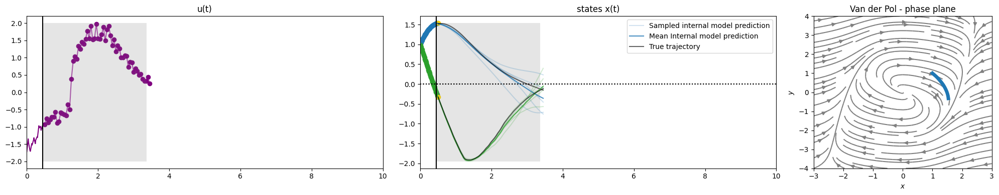

Traj. opt. times:  [10.2103, 10.2726, 10.0156, 9.9897, 10.2624, 10.1702, 9.9507, 9.8418, 9.9033, 9.9088]


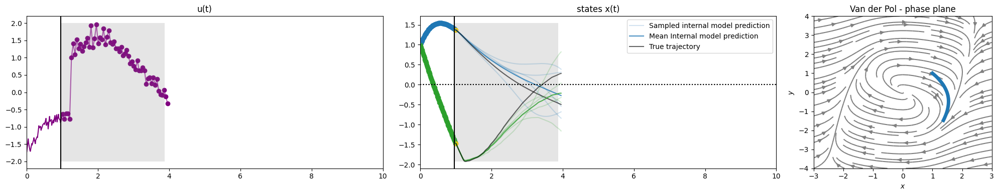

Traj. opt. times:  [10.0929, 9.8941, 10.1413, 10.6405, 10.3203, 10.2762, 10.2949, 9.93, 9.9291, 10.0395]


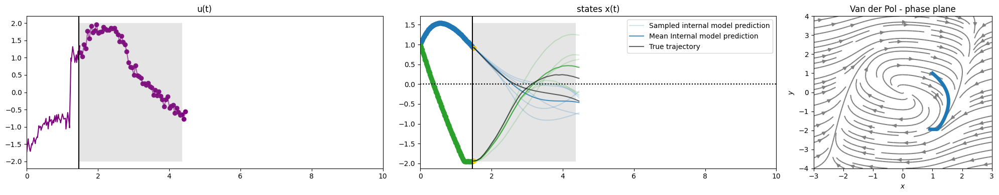

Traj. opt. times:  [10.352, 10.4775, 9.6425, 9.7441, 9.6199, 9.6573, 9.5177, 9.4874, 9.6169, 9.847]


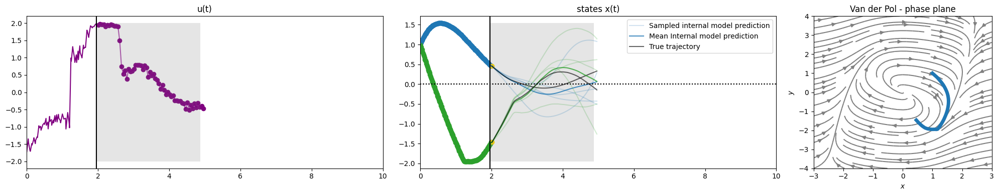

Traj. opt. times:  [9.8355, 9.7977, 9.8306, 10.625, 10.8636, 10.4362, 10.8641, 10.389, 10.552, 10.8799]


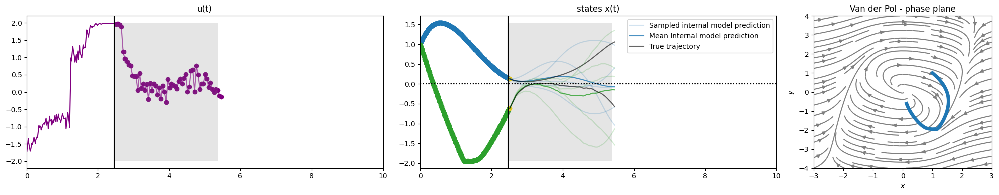

Traj. opt. times:  [12.0018, 11.8971, 11.9893, 12.601, 11.1731, 12.0398, 12.3542, 11.7998, 12.7164, 12.9443]


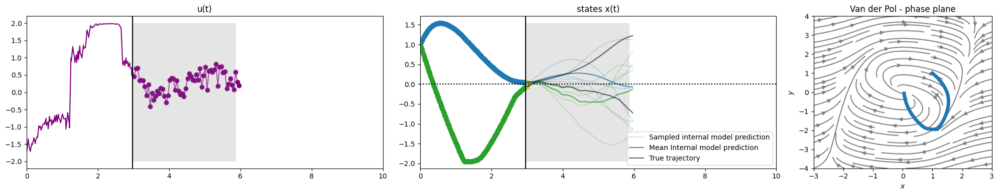

Traj. opt. times:  [12.5733, 12.2949, 12.3235, 13.3886, 12.0648, 12.778, 13.2286, 12.9405, 13.4087, 13.3802]


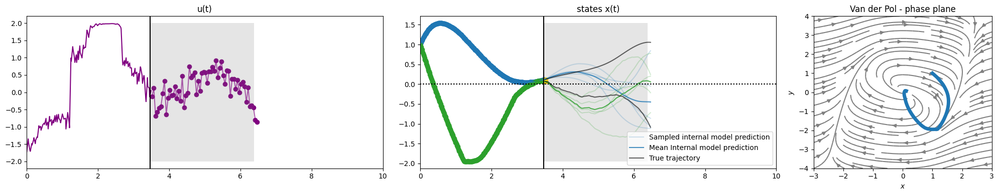

Traj. opt. times:  [11.7266, 12.3969, 12.9086, 15.2501, 12.9357, 13.2974, 12.2242, 12.0449, 13.5203, 14.8991]


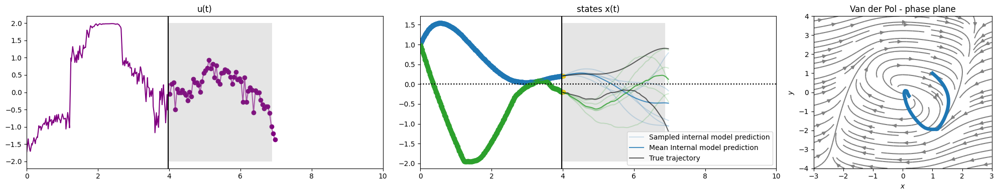

Traj. opt. times:  [16.246, 12.7735, 12.0527, 13.1751, 11.7026, 11.61, 12.4391, 12.306, 12.3475, 12.1914]


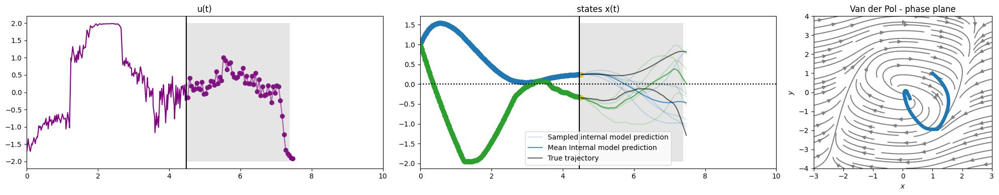

Traj. opt. times:  [12.3717, 12.1574, 12.2466, 13.2441, 11.9639, 11.9223, 11.8513, 11.8038, 11.8109, 12.0099]


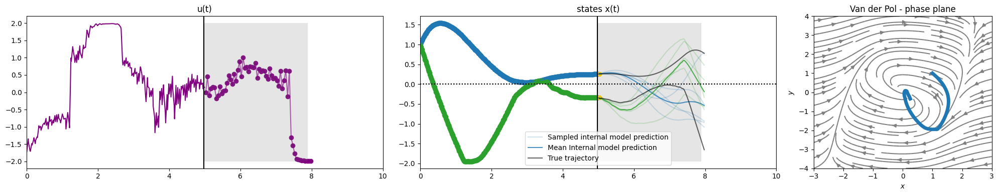

Traj. opt. times:  [12.6425, 11.388, 10.6783, 11.0743, 10.6165, 10.6757, 10.684, 10.4832, 10.6598, 10.3558]


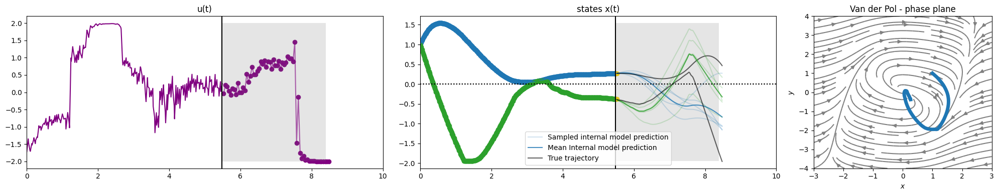

Traj. opt. times:  [10.52, 10.2812, 10.2637, 10.2719, 10.3887, 10.0842, 10.0118, 10.1338, 9.9961, 9.816]


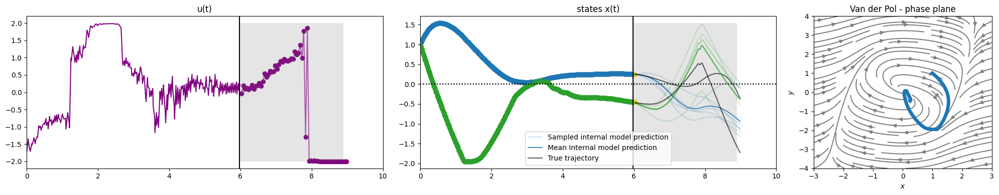

Traj. opt. times:  [9.8452, 9.6008, 9.6085, 9.3843, 9.3829, 9.4442, 9.4968, 9.4213, 9.3596, 9.3516]


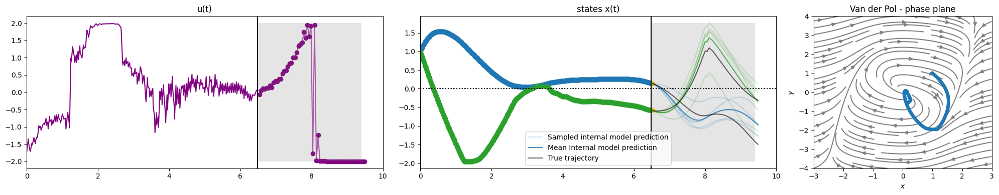

Traj. opt. times:  [9.35, 9.2246, 9.2965, 9.1915, 9.1912, 9.0276, 9.1656, 9.3005, 9.0301, 9.1884]


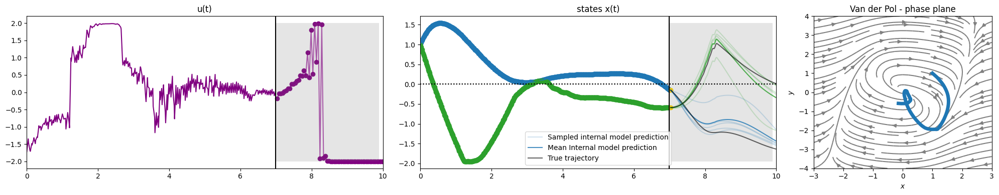

Traj. opt. times:  [9.2805, 9.1624, 9.0049, 8.9542, 8.8845, 8.9368, 9.2669, 8.8414, 9.2155, 8.9708]


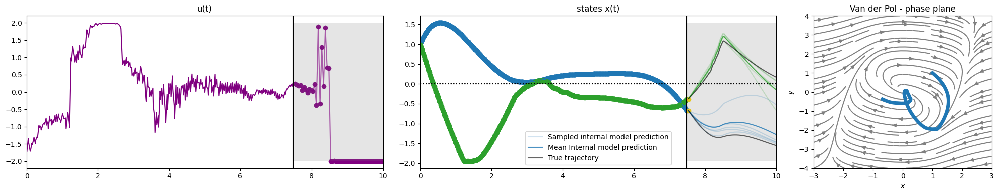

Traj. opt. times:  [8.9237, 9.1587, 8.8581, 8.9046, 8.7705, 8.6883, 8.6302, 8.7267, 8.7994, 8.607]


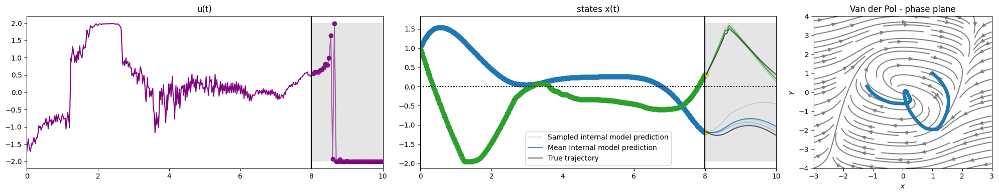

Traj. opt. times:  [9.0556, 8.9927, 8.6574, 8.7919, 8.722, 8.6967, 8.7354, 8.6498, 8.7143, 8.6791]


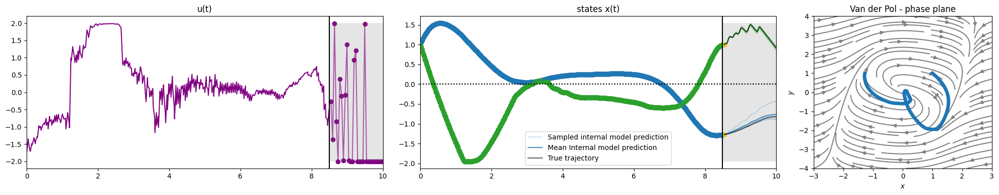

Traj. opt. times:  [8.8488, 8.623, 8.7224, 9.0611, 8.7124, 8.7921, 8.8081, 8.6336, 8.6056, 8.6476]


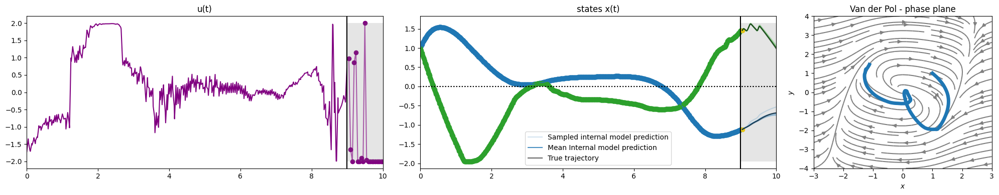

Traj. opt. times:  [8.657, 8.5575, 8.5638, 8.6409, 8.6265, 8.5146, 8.7247, 8.8356, 8.6206, 8.519]


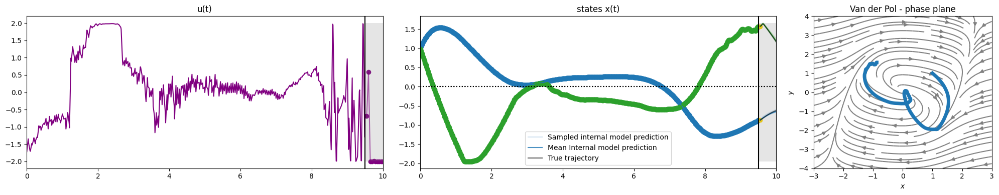

Traj. opt. times:  [8.5997, 8.8244, 8.5248, 8.6081, 8.8214, 8.5202, 8.5589, 8.4162, 8.593, 9.1965]


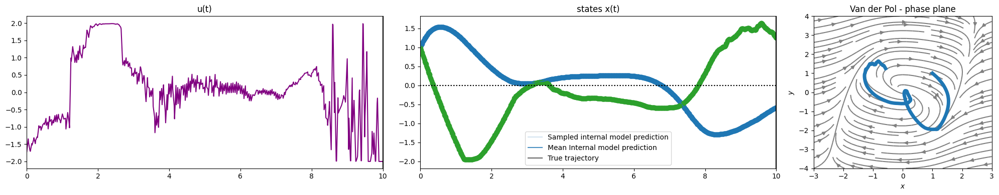

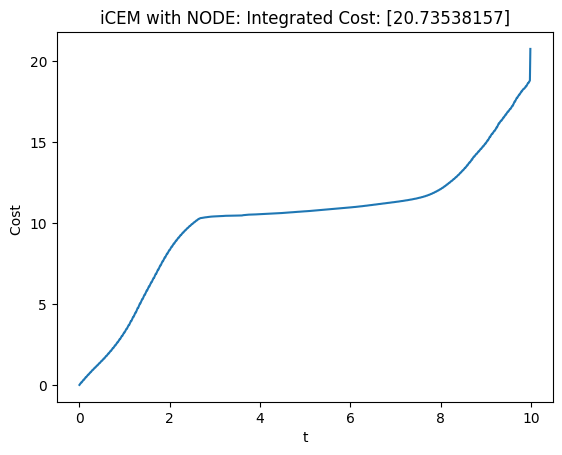

In [14]:
from ppc.control.trajectory_optimizers import *
from ppc.control.mpc import ensembleDirectMPC

H = 3
n_controls = int(H/env.Delta_t)
# trial_ts = jnp.arange(env.t0, env.tf, env.Delta_t)

cem_solver = CEM(
                lb=env.lb*jnp.ones((n_controls, env.D_control)),
                ub=env.ub*jnp.ones((n_controls, env.D_control)),
                maxiter=maxiter,
                pop_size=700,
                elite_size=int(0.13*500),
                alpha=0.3,
                init_var=1)


ensemble_mpc = ensembleDirectMPC(
            traj_optimizer=cem_solver,
            real_system=real_system,
            internal_system=opt_ensemble_node,
            state_cost=env.state_cost,
            termination_cost=env.termination_cost,
            verbose=True,
            )

# run with ground truth as internal model
ts, ts_dense, X, ys, U, R = ensemble_mpc.simulate(
                        x0=env.get_initial_condition(subkey), 
                        ts=trial_ts,
                        Delta_t=env.Delta_t,
                        x_star=env.x_star,
                        dt0_dense=dt0_dense,
                        H=H,
                        obs_noise=0.,
                        key=subkey,
                    )
key, subkey = jr.split(key)

cem_ensemble_trial_cost = R[-1]
plt.plot(ts_dense, R)
plt.title(f'iCEM with NODE: Integrated Cost: {R[-1]}')
plt.ylabel('Cost ')
plt.xlabel('t')
plt.show()

## Adam - ensemble

Traj. opt. times:  [0.0618, 0.0645, 0.0654, 0.0644, 0.0765, 0.067, 0.0655, 0.0673, 0.0653, 0.0642]


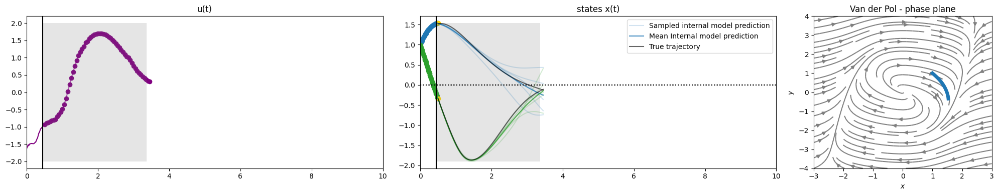

Traj. opt. times:  [0.0625, 0.0638, 0.0623, 0.0633, 0.0633, 0.066, 0.0626, 0.0622, 0.0618, 0.0642]


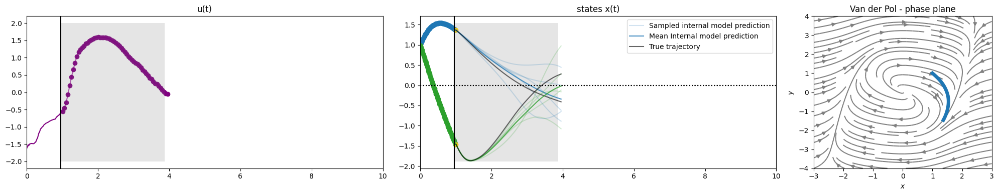

Traj. opt. times:  [0.0639, 0.0616, 0.0617, 0.0642, 0.07, 0.0714, 0.0631, 0.0632, 0.0615, 0.0621]


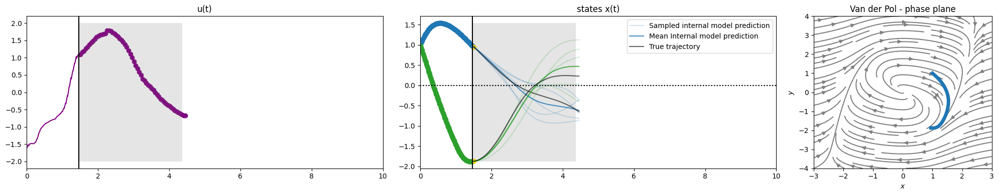

Traj. opt. times:  [0.0672, 0.0626, 0.0621, 0.0609, 0.0628, 0.0599, 0.0656, 0.0613, 0.0607, 0.0614]


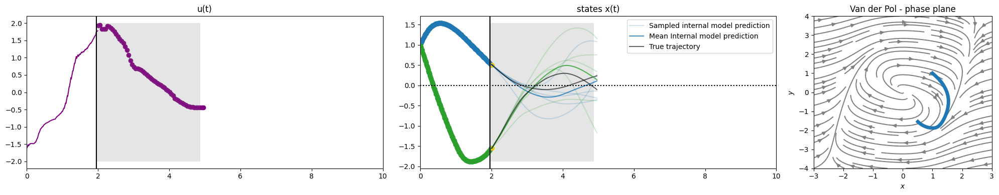

Traj. opt. times:  [0.0604, 0.059, 0.0602, 0.0606, 0.0603, 0.06, 0.0636, 0.0605, 0.0598, 0.0595]


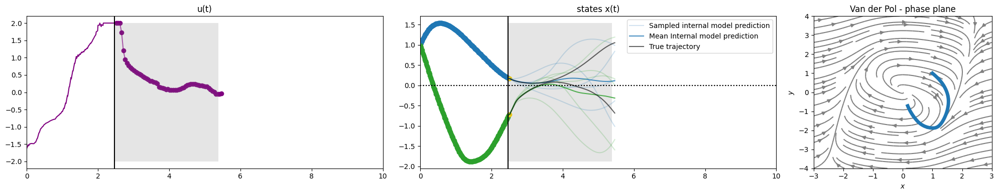

Traj. opt. times:  [0.0599, 0.06, 0.0595, 0.0601, 0.062, 0.0635, 0.061, 0.0846, 0.0711, 0.0637]


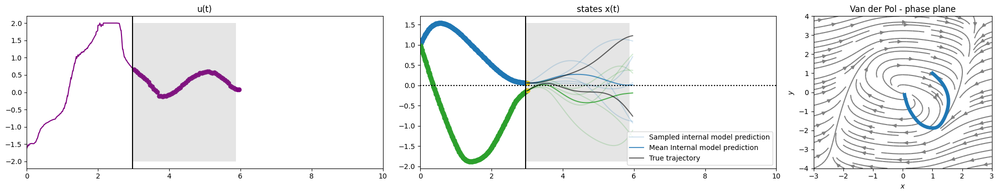

Traj. opt. times:  [0.0609, 0.061, 0.0599, 0.0613, 0.062, 0.061, 0.0622, 0.0612, 0.0607, 0.0622]


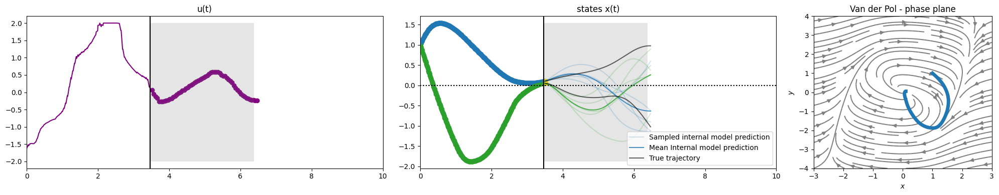

Traj. opt. times:  [0.0583, 0.0579, 0.0582, 0.0585, 0.0583, 0.0582, 0.0583, 0.0582, 0.0578, 0.0581]


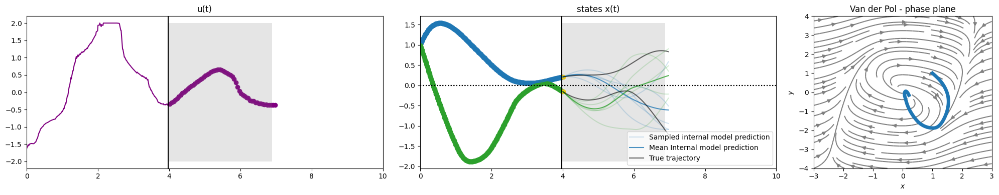

Traj. opt. times:  [0.0579, 0.0576, 0.0577, 0.0578, 0.0576, 0.0574, 0.058, 0.0579, 0.0578, 0.0577]


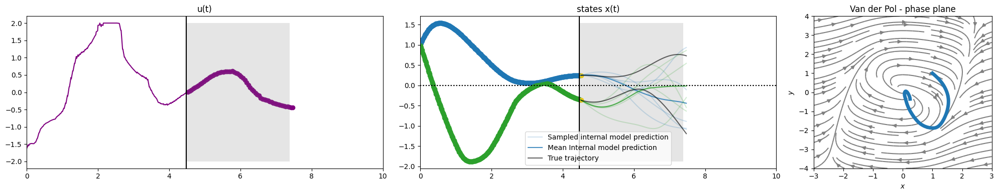

Traj. opt. times:  [0.0573, 0.0569, 0.0572, 0.0583, 0.0705, 0.0637, 0.0625, 0.0621, 0.0605, 0.0635]


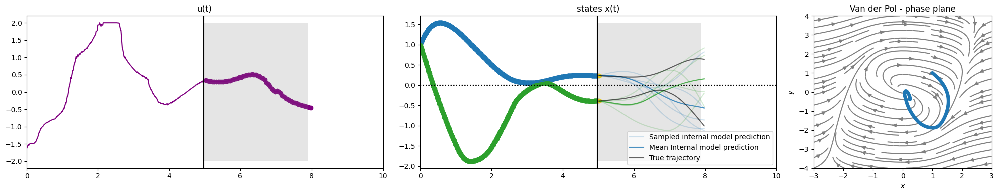

Traj. opt. times:  [0.0595, 0.0586, 0.0583, 0.0587, 0.0588, 0.0599, 0.0618, 0.0585, 0.0593, 0.0602]


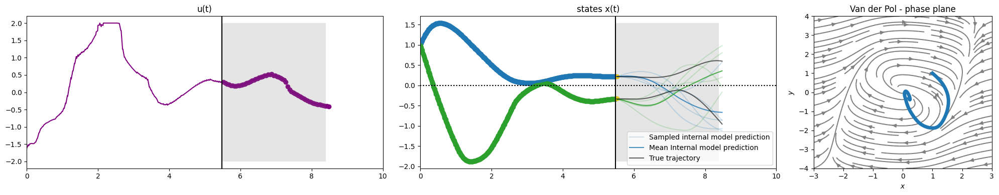

Traj. opt. times:  [0.0643, 0.0668, 0.0601, 0.0587, 0.0628, 0.0591, 0.0626, 0.0591, 0.0603, 0.0615]


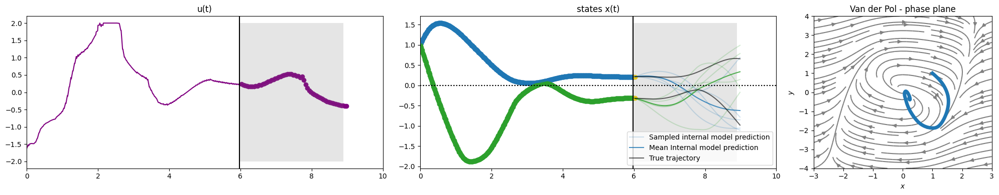

Traj. opt. times:  [0.0602, 0.0605, 0.0599, 0.0629, 0.0621, 0.0673, 0.0615, 0.0644, 0.0626, 0.0614]


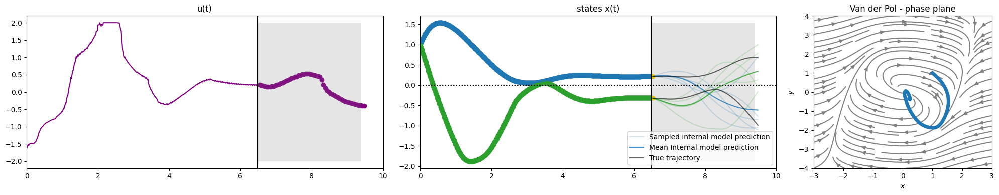

Traj. opt. times:  [0.0896, 0.0595, 0.0609, 0.0598, 0.064, 0.0626, 0.0623, 0.0621, 0.0621, 0.0621]


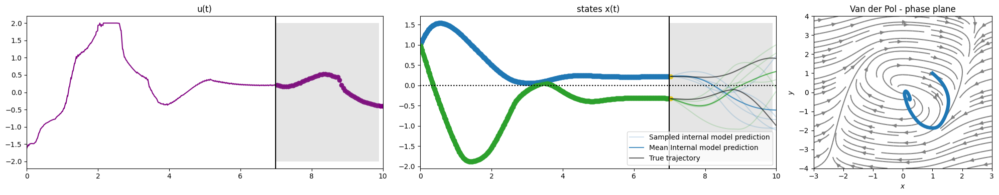

Traj. opt. times:  [0.0637, 0.0616, 0.0599, 0.0609, 0.0622, 0.0605, 0.068, 0.0633, 0.0836, 0.1]


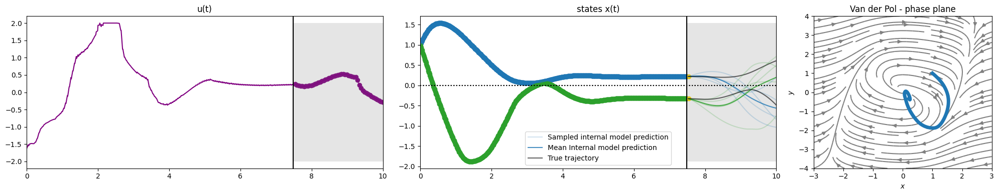

Traj. opt. times:  [0.0755, 0.0627, 0.0613, 0.0599, 0.0595, 0.0589, 0.0586, 0.059, 0.0591, 0.0592]


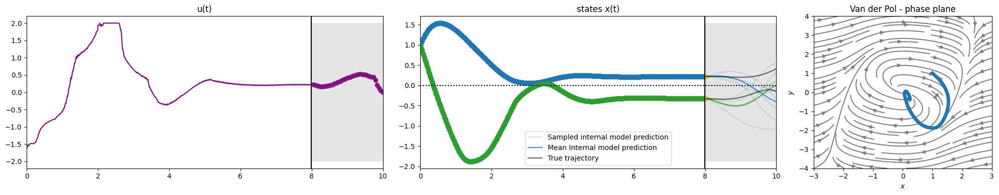

Traj. opt. times:  [0.0634, 0.0593, 0.0588, 0.0601, 0.0595, 0.0598, 0.0601, 0.059, 0.0591, 0.0586]


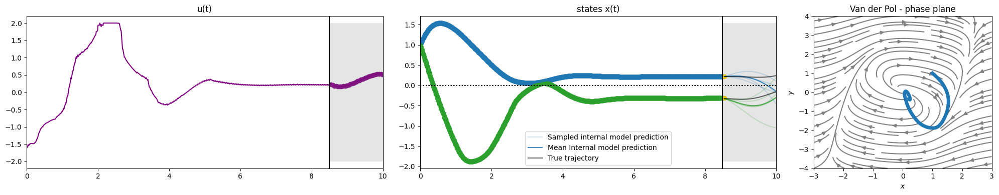

Traj. opt. times:  [0.07, 0.059, 0.0582, 0.0582, 0.0589, 0.0587, 0.0589, 0.059, 0.0585, 0.0591]


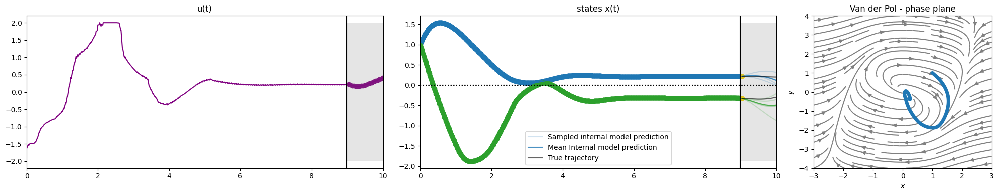

Traj. opt. times:  [0.0617, 0.0591, 0.0575, 0.0572, 0.0576, 0.057, 0.0571, 0.0576, 0.057, 0.057]


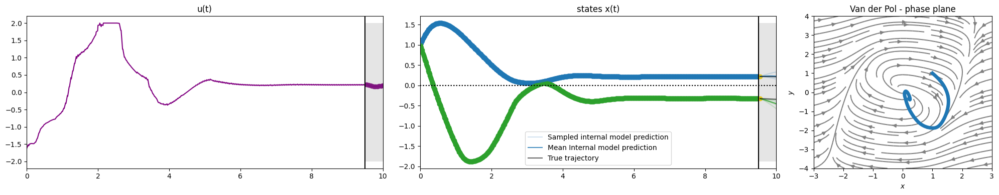

Traj. opt. times:  [0.0589, 0.0568, 0.0568, 0.0568, 0.0568, 0.0568, 0.0571, 0.0563, 0.0569, 0.0568]


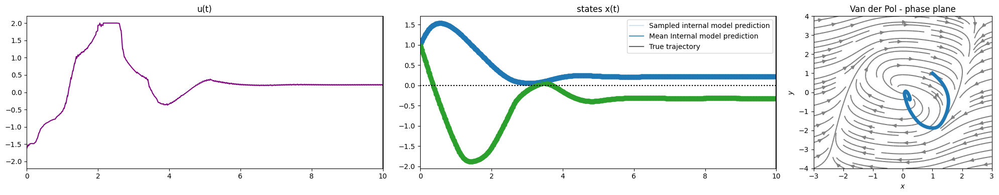

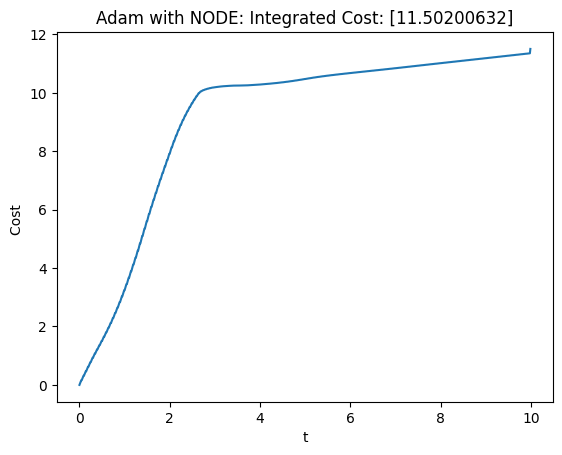

In [15]:
from ppc.control.trajectory_optimizers import *
from ppc.control.mpc import ensembleDirectMPC

H = 3
n_controls = int(H/env.Delta_t)
# trial_ts = jnp.arange(env.t0, env.tf, env.Delta_t)

adam_solver = Adam(
                lb=env.lb*jnp.ones((n_controls, env.D_control)),
                ub=env.ub*jnp.ones((n_controls, env.D_control)),
                maxiter=maxiter,)


ensemble_mpc = ensembleDirectMPC(
            traj_optimizer=adam_solver,
            real_system=real_system,
            internal_system=opt_ensemble_node,
            state_cost=env.state_cost,
            termination_cost=env.termination_cost,
            verbose=True,
            )

# run with ground truth as internal model
ts, ts_dense, X, ys, U, R = ensemble_mpc.simulate(
                        x0=env.get_initial_condition(subkey), 
                        ts=trial_ts,
                        Delta_t=env.Delta_t,
                        x_star=env.x_star,
                        dt0_dense=dt0_dense,
                        H=H,
                        obs_noise=0.,
                        key=subkey,
                    )
key, subkey = jr.split(key)

adam_ensemble_trial_cost = R[-1]
plt.plot(ts_dense, R)
plt.title(f'Adam with NODE: Integrated Cost: {R[-1]}')
plt.ylabel('Cost ')
plt.xlabel('t')
plt.show()

## BFGS - ensemble

Traj. opt. times:  [0.0805, 0.0883, 0.0798, 0.0844, 0.0881, 0.0823, 0.0842, 0.0821, 0.0986, 0.0826]


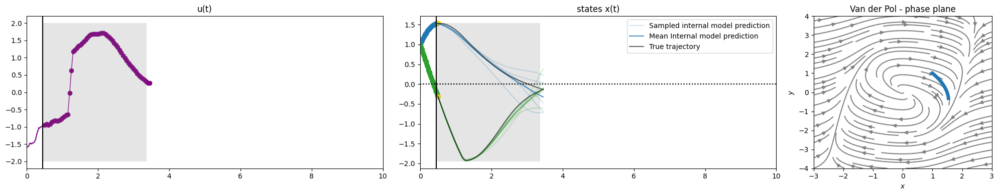

Traj. opt. times:  [0.0905, 0.0912, 0.095, 0.0905, 0.0905, 0.0908, 0.0964, 0.108, 0.0778, 0.0934]


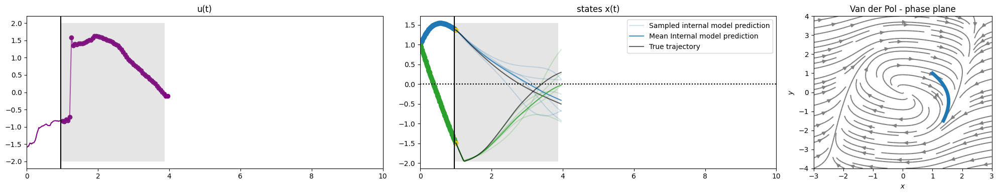

Traj. opt. times:  [0.1117, 0.114, 0.1061, 0.1032, 0.1061, 0.1142, 0.0859, 0.0977, 0.0885, 0.0878]


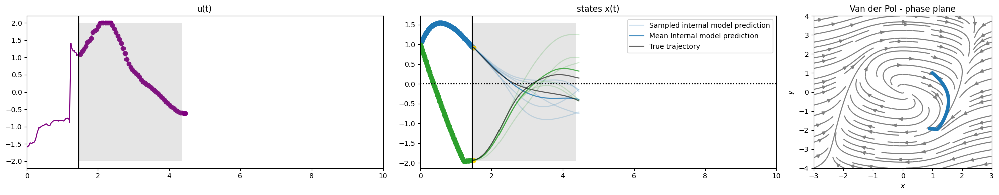

Traj. opt. times:  [0.1314, 0.0864, 0.1011, 0.0935, 0.0938, 0.1006, 0.1008, 0.0732, 0.0895, 0.0871]


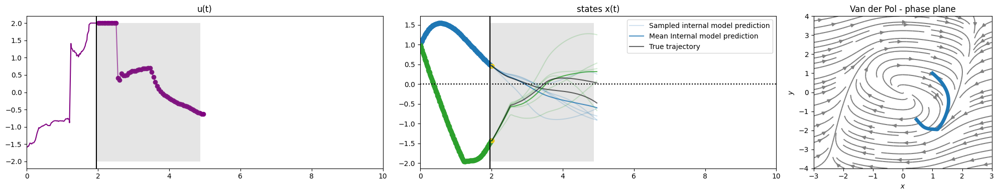

Traj. opt. times:  [0.1802, 0.0959, 0.0828, 0.0848, 0.0901, 0.0857, 0.076, 0.0774, 0.0849, 0.077]


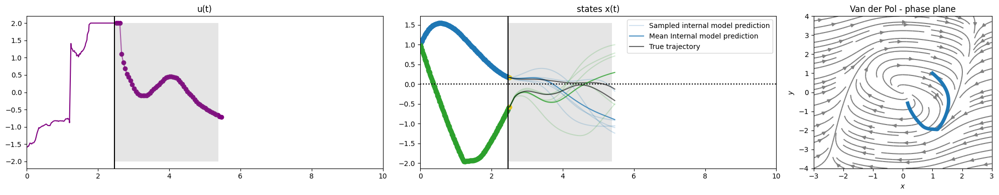

Traj. opt. times:  [0.1076, 0.1317, 0.0955, 0.0866, 0.0872, 0.0889, 0.0947, 0.1265, 0.1141, 0.094]


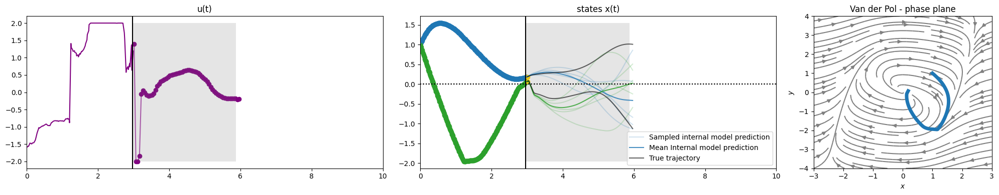

Traj. opt. times:  [0.122, 0.0984, 0.0996, 0.0991, 0.0982, 0.1205, 0.1057, 0.0888, 0.0919, 0.096]


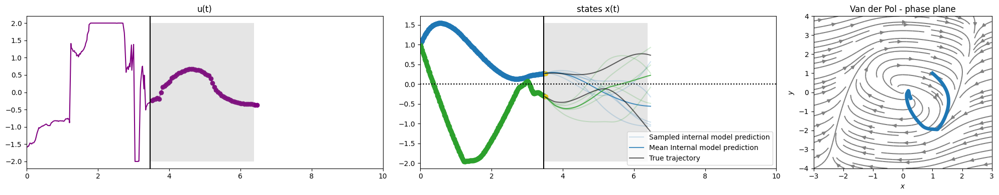

Traj. opt. times:  [0.2034, 0.1017, 0.088, 0.0874, 0.0871, 0.0873, 0.0894, 0.1119, 0.1047, 0.0933]


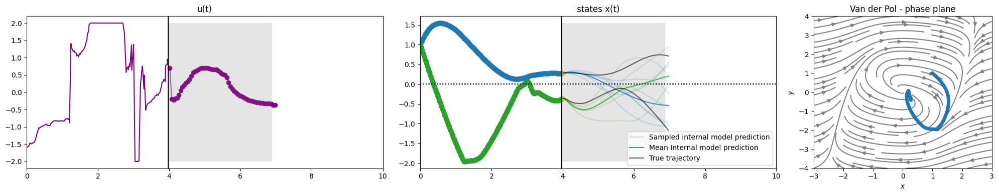

Traj. opt. times:  [0.0904, 0.1055, 0.0902, 0.0894, 0.0911, 0.0892, 0.0889, 0.1176, 0.1144, 0.1199]


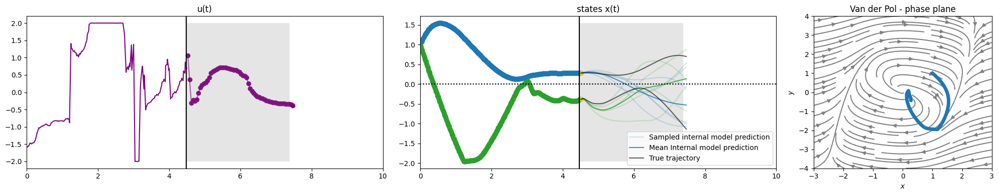

Traj. opt. times:  [0.1049, 0.0968, 0.1039, 0.0884, 0.0898, 0.0877, 0.0886, 0.0916, 0.1351, 0.082]


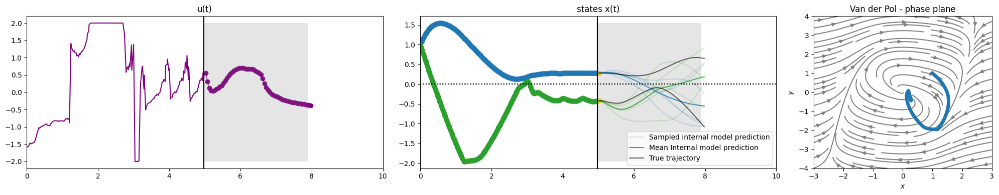

Traj. opt. times:  [0.1265, 0.1047, 0.0829, 0.1044, 0.0898, 0.0881, 0.0885, 0.0935, 0.09, 0.0919]


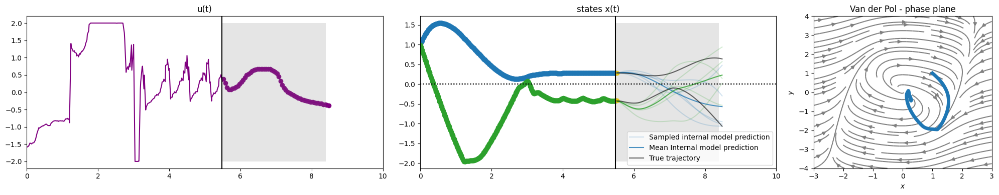

Traj. opt. times:  [0.0952, 0.1046, 0.105, 0.0849, 0.0889, 0.1037, 0.088, 0.0876, 0.0885, 0.0904]


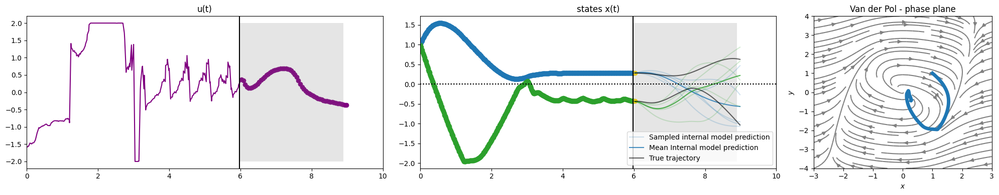

Traj. opt. times:  [0.0923, 0.0852, 0.0864, 0.0958, 0.1276, 0.1195, 0.0941, 0.089, 0.0856, 0.104]


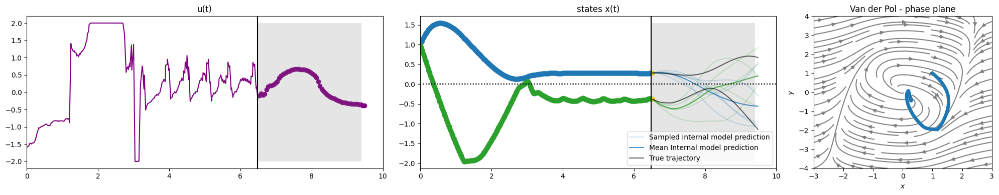

Traj. opt. times:  [0.1748, 0.0953, 0.1642, 0.089, 0.094, 0.1095, 0.1146, 0.0938, 0.0868, 0.1386]


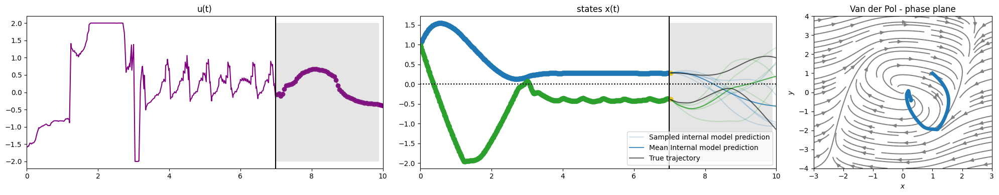

Traj. opt. times:  [0.1125, 0.1918, 0.1439, 0.0924, 0.0942, 0.0829, 0.0864, 0.0867, 0.089, 0.1105]


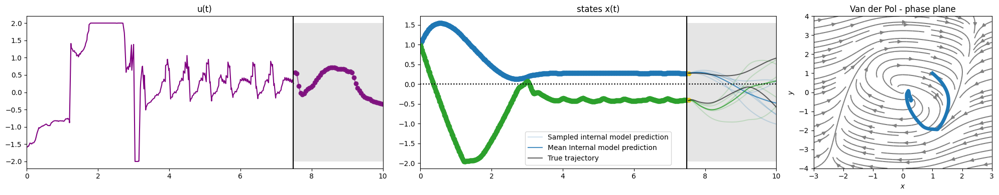

Traj. opt. times:  [0.1147, 0.0988, 0.0901, 0.1073, 0.09, 0.0891, 0.0998, 0.112, 0.0964, 0.1615]


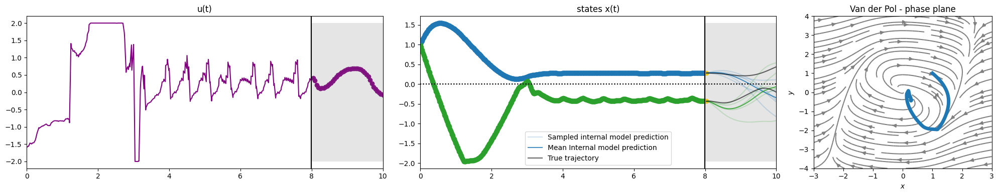

Traj. opt. times:  [0.0884, 0.0849, 0.0845, 0.1012, 0.102, 0.1096, 0.1102, 0.116, 0.113, 0.0897]


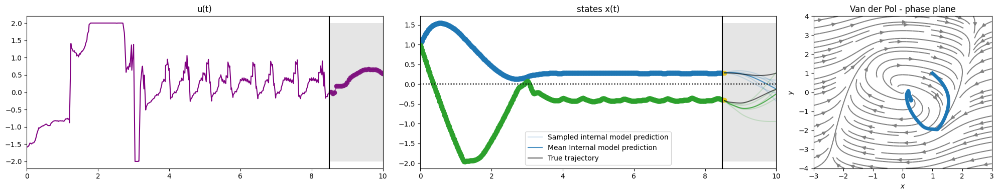

Traj. opt. times:  [0.0942, 0.0889, 0.0891, 0.0884, 0.0838, 0.0844, 0.0795, 0.0802, 0.0806, 0.0808]


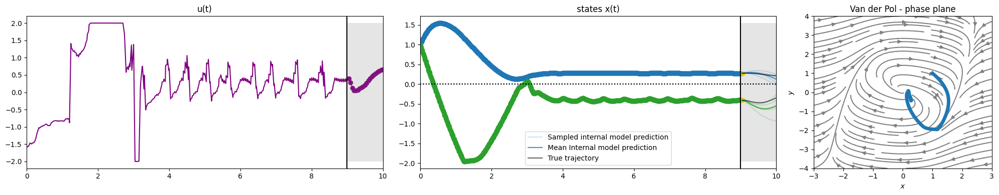

Traj. opt. times:  [0.0875, 0.0826, 0.0998, 0.0963, 0.0925, 0.0927, 0.0994, 0.0876, 0.1025, 0.0878]


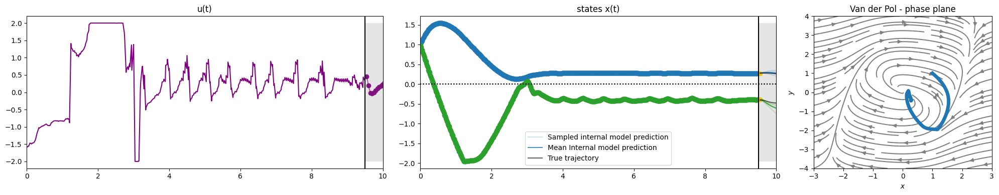

Traj. opt. times:  [0.0975, 0.0774, 0.0843, 0.0845, 0.0848, 0.0927, 0.1052, 0.0851, 0.0841, 0.1122]


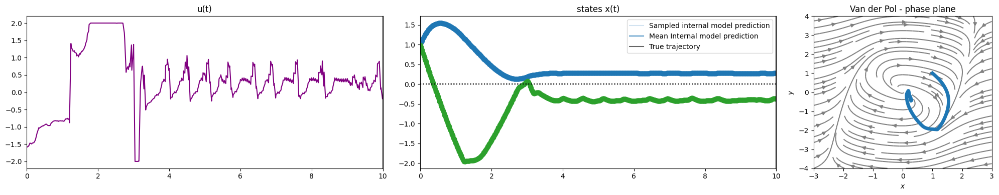

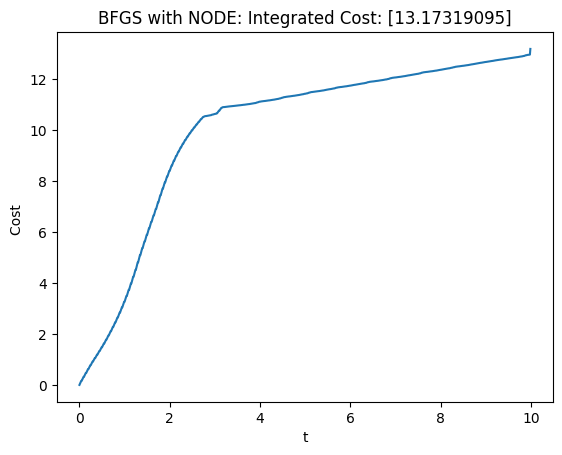

In [16]:
from ppc.control.trajectory_optimizers import *
from ppc.control.mpc import ensembleDirectMPC

H = 3
n_controls = int(H/env.Delta_t)
# trial_ts = jnp.arange(env.t0, env.tf, env.Delta_t)

bfgs_solver = LBFGSB(
                lb=env.lb*jnp.ones((n_controls, env.D_control)),
                ub=env.ub*jnp.ones((n_controls, env.D_control)),
                maxiter=maxiter,)

ensemble_mpc = ensembleDirectMPC(
            traj_optimizer=bfgs_solver,
            real_system=real_system,
            internal_system=opt_ensemble_node,
            state_cost=env.state_cost,
            termination_cost=env.termination_cost,
            verbose=True,
            )

# run with ground truth as internal model
ts, ts_dense, X, ys, U, R = ensemble_mpc.simulate(
                        x0=env.get_initial_condition(subkey), 
                        ts=trial_ts,
                        Delta_t=env.Delta_t,
                        x_star=env.x_star,
                        dt0_dense=dt0_dense,
                        H=H,
                        obs_noise=0.,
                        key=subkey,
                    )
key, subkey = jr.split(key)


bfgs_ensemble_trial_cost = R[-1]
plt.plot(ts_dense, R)
plt.title(f'BFGS with NODE: Integrated Cost: {R[-1]}')
plt.ylabel('Cost ')
plt.xlabel('t')
plt.show()

## indirect approach

In [17]:
from ppc.control.trajectory_optimizers import EnsemblePMPForward
from ppc.control.mpc import ensembleDirectMPC, ensembleIndirectMPC

n_segments = 4
pmp_solver = EnsemblePMPForward(f=opt_ensemble_node.vectorfield,
                        D_sys=real_system.D_sys, 
                        D_control=real_system.D_control,
                        ensemble_size=ensemble_size,
                        n_segments=n_segments,
                        state_cost=env.state_cost,
                        termination_cost=env.termination_cost,
                        maxiter=maxiter, 
                        lb=env.lb*jnp.ones((n_controls, real_system.D_control)), 
                        ub=env.ub*jnp.ones((n_controls, real_system.D_control)),
                        )


ensemble_indirect_mpc = ensembleIndirectMPC(traj_optimizer=pmp_solver,
            real_system=real_system,
            internal_system=opt_ensemble_node,
            state_cost=env.state_cost,
            termination_cost=env.termination_cost,
            verbose=True,
            )

Initial optimization (iteration 0) not succesfull, continuing.
Initial optimization (iteration 1) not succesfull, continuing.
Initial optimization (iteration 2) not succesfull, continuing.
Initial optimization (iteration 3) not succesfull, continuing.
Initial optimization (iteration 4) not succesfull, continuing.
Initial optimization (iteration 5) not succesfull, continuing.
Initial optimization (iteration 6) not succesfull, continuing.
Initial optimization (iteration 7) not succesfull, continuing.
Initial optimization (iteration 8) not succesfull, continuing.
Initial optimization (iteration 9) not succesfull, continuing.
Initial optimization (iteration 10) not succesfull, continuing.
Initial optimization (iteration 11) not succesfull, continuing.
Initial optimization (iteration 12) not succesfull, continuing.
Initial optimization (iteration 13) not succesfull, continuing.
Initial optimization (iteration 14) not succesfull, continuing.
Initial optimization (iteration 15) not succesfull

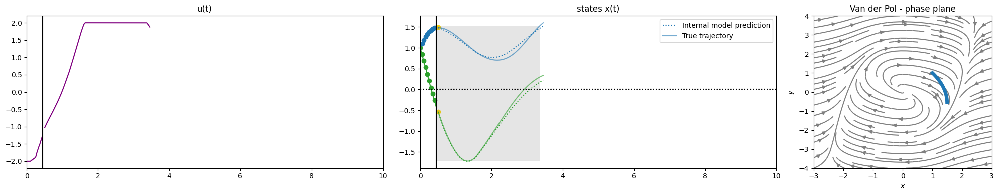

Traj. opt. times:  [(3.1705, 11), (3.2227, 11), (3.1863, 11), (3.1165, 11), (2.8984, 10), (2.9281, 10), (2.9562, 10), (2.9847, 10), (2.8836, 10), (3.1758, 11)]


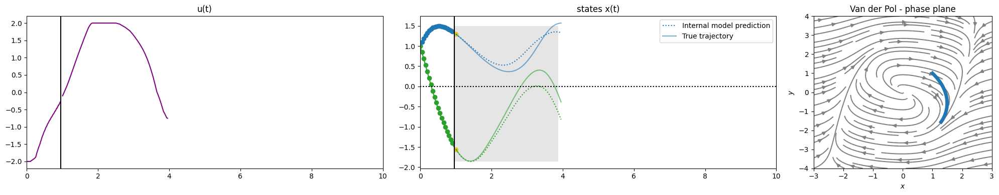

Traj. opt. times:  [(3.0023, 11), (2.9727, 11), (2.7212, 10), (2.9538, 11), (2.9191, 11), (3.0004, 11), (2.974, 11), (2.9836, 11), (2.9902, 11), (2.9091, 11)]


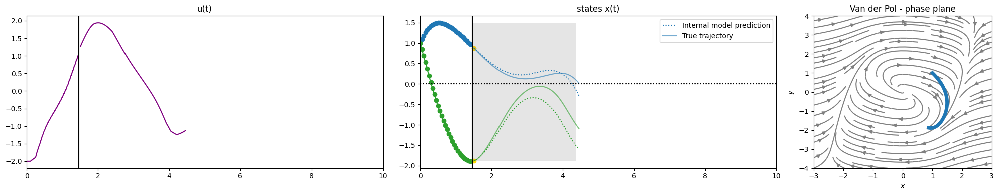

Traj. opt. times:  [(2.9786, 11), (4.0359, 15), (4.0734, 15), (4.0494, 15), (3.9701, 15), (3.9213, 15), (4.0307, 15), (4.144, 15), (4.2797, 15), (4.2573, 15)]


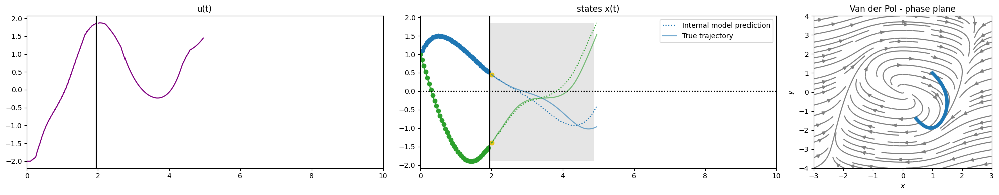

Traj. opt. times:  [(4.2565, 15), (4.1893, 15), (4.3046, 15), (4.1616, 15), (4.1625, 15), (4.3226, 15), (3.6594, 13), (4.0868, 14), (3.2475, 12), (3.3717, 12)]


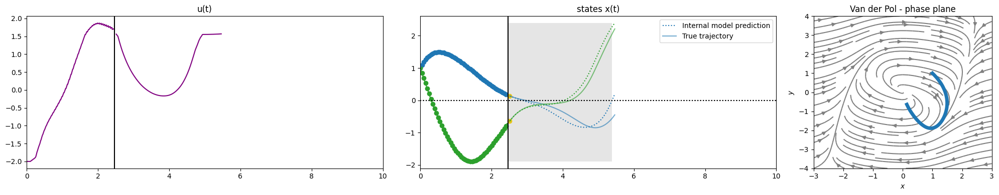

Traj. opt. times:  [(3.3922, 12), (3.3886, 12), (3.1331, 11), (2.9344, 11), (3.0825, 11), (3.3813, 12), (3.3605, 12), (3.4094, 12), (3.3985, 12), (3.201, 12)]


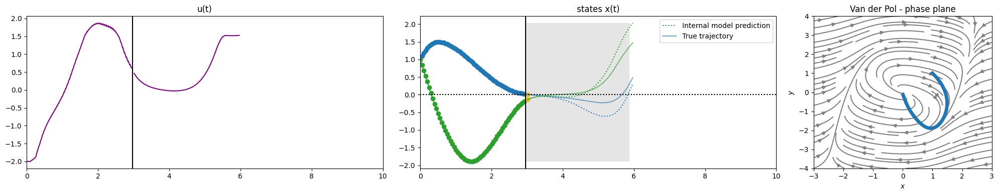

Traj. opt. times:  [(3.4544, 12), (3.344, 12), (3.3807, 12), (3.2507, 12), (3.314, 12), (3.3377, 12), (3.3711, 12), (3.4186, 12), (3.3927, 12), (3.313, 12)]


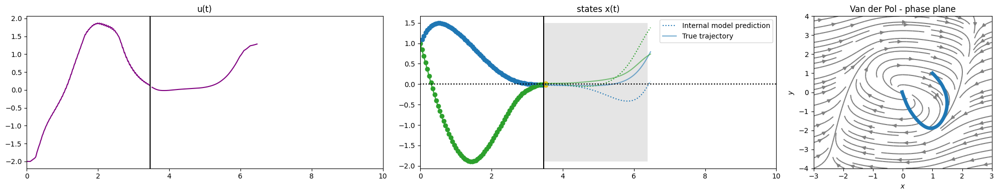

Traj. opt. times:  [(3.4754, 12), (3.4388, 12), (3.3137, 12), (3.3871, 12), (3.4024, 12), (3.4174, 12), (3.3975, 12), (3.2522, 12), (3.3378, 12), (3.2799, 12)]


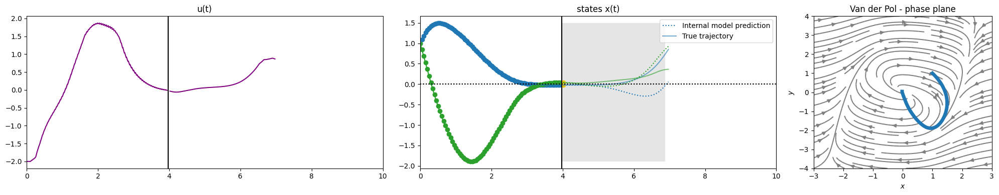

Traj. opt. times:  [(3.4456, 12), (3.3639, 12), (3.2149, 12), (3.3177, 12), (3.3821, 12), (3.3212, 12), (3.4311, 12), (3.308, 12), (3.3534, 12), (3.4276, 12)]


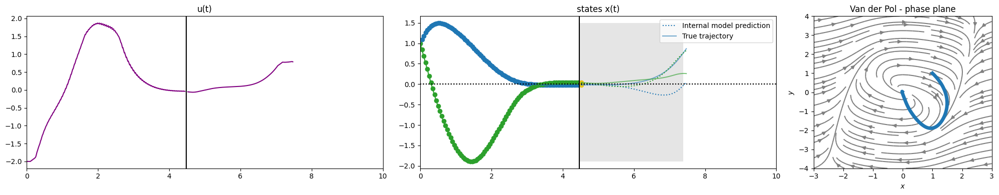

Traj. opt. times:  [(3.2863, 12), (3.4, 12), (3.4638, 12), (3.4997, 12), (3.5188, 12), (3.4157, 12), (3.4164, 12), (3.2634, 12), (3.431, 12), (3.435, 12)]


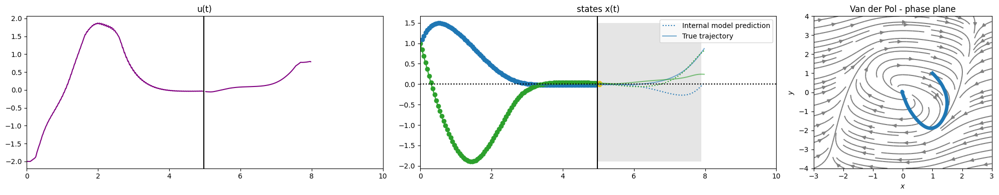

Traj. opt. times:  [(3.5241, 12), (3.237, 12), (3.3821, 12), (3.5408, 12), (3.4268, 12), (3.3538, 12), (3.3676, 12), (3.4464, 12), (3.4647, 12), (3.4052, 12)]


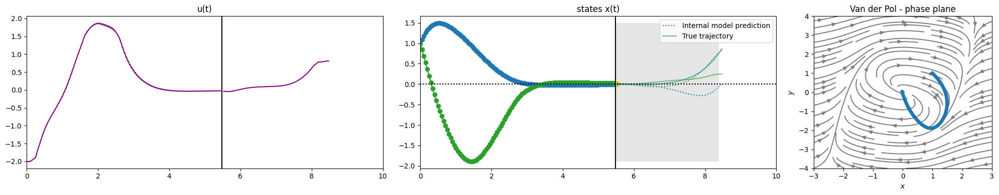

Traj. opt. times:  [(3.6605, 12), (3.5409, 12), (3.5974, 12), (3.4376, 12), (3.4316, 12), (3.371, 12), (3.4199, 12), (3.3882, 12), (3.2437, 12), (3.3981, 12)]


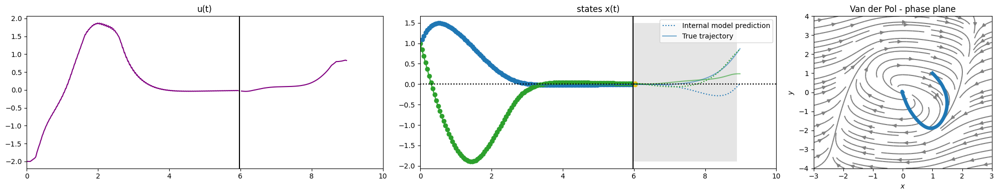

Traj. opt. times:  [(3.5851, 12), (3.5154, 12), (3.2168, 12), (3.3433, 12), (3.4958, 12), (3.3472, 12), (3.4336, 12), (3.4805, 12), (3.1819, 12), (3.3567, 12)]


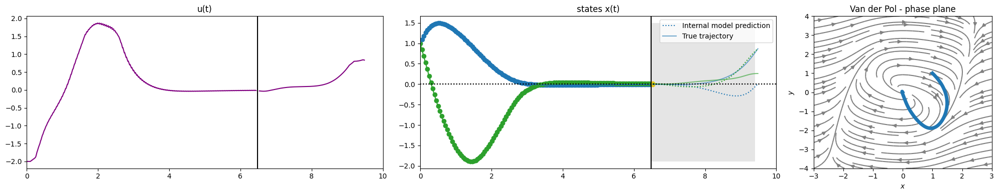

Traj. opt. times:  [(3.6034, 12), (3.2571, 12), (3.4594, 12), (3.3811, 12), (3.4355, 12), (3.4485, 12), (3.479, 12), (3.2551, 12), (3.4979, 12), (3.4445, 12)]


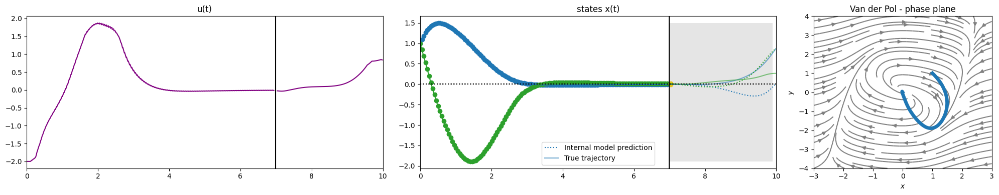

Traj. opt. times:  [(3.5701, 12), (3.2368, 12), (3.6376, 12), (3.5012, 12), (3.4402, 12), (3.3718, 12), (3.617, 12), (3.4936, 12), (3.4298, 12), (3.5314, 12)]


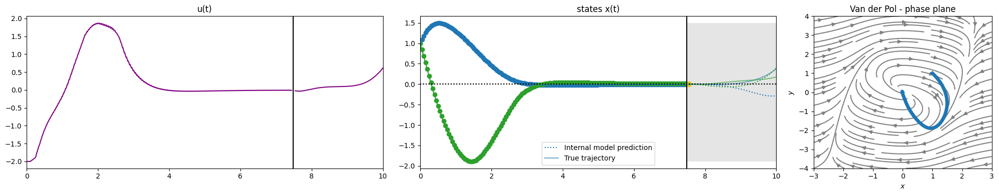

Traj. opt. times:  [(3.5461, 12), (3.4202, 12), (3.4624, 12), (3.4213, 12), (3.3688, 12), (3.4164, 12), (3.4576, 12), (3.332, 12), (3.5005, 12), (3.4857, 12)]


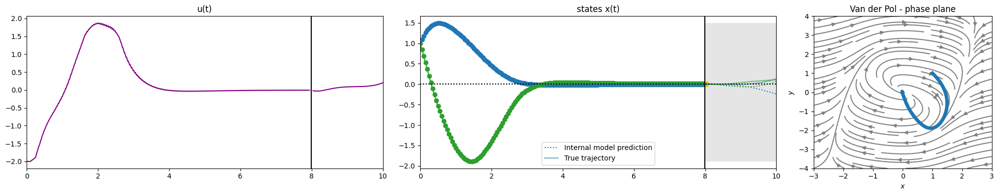

Traj. opt. times:  [(3.5083, 12), (3.3703, 12), (3.4954, 12), (3.4098, 12), (3.2152, 12), (3.4218, 12), (3.335, 12), (3.4855, 12), (3.4056, 12), (3.371, 12)]


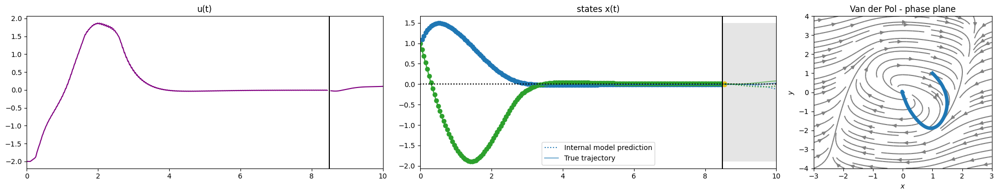

Traj. opt. times:  [(3.6215, 12), (3.4251, 12), (3.4181, 12), (3.4082, 12), (3.3361, 12), (3.4121, 12), (3.5772, 12), (3.2802, 12), (3.4497, 12), (3.4003, 12)]


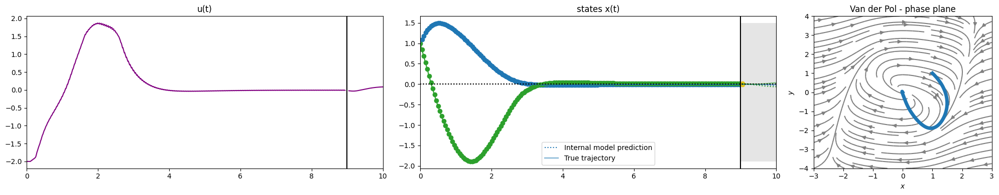

Traj. opt. times:  [(3.4604, 12), (3.4953, 12), (3.4431, 12), (3.2718, 12), (3.2996, 12), (3.4537, 12), (3.495, 12), (3.3113, 12), (3.3355, 12), (3.5581, 12)]


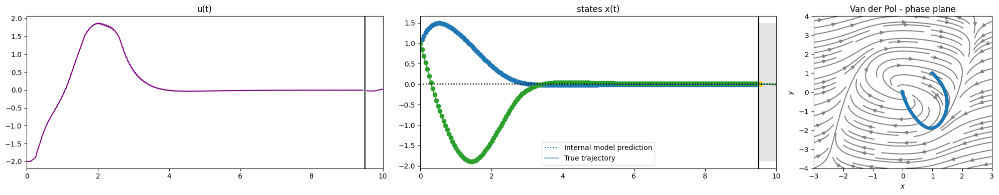

Traj. opt. times:  [(3.5617, 12), (3.4817, 12), (3.3844, 12), (3.4589, 12), (3.3527, 12), (3.3283, 12), (3.3591, 12), (3.2358, 12), (3.3666, 12), (3.4802, 12)]


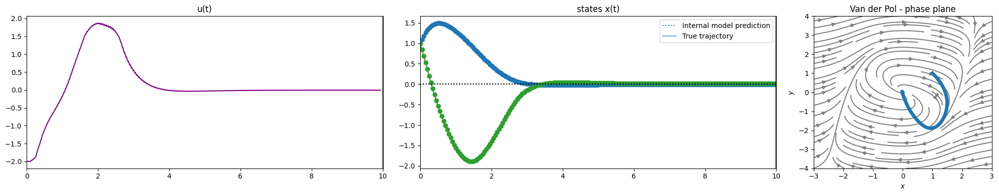

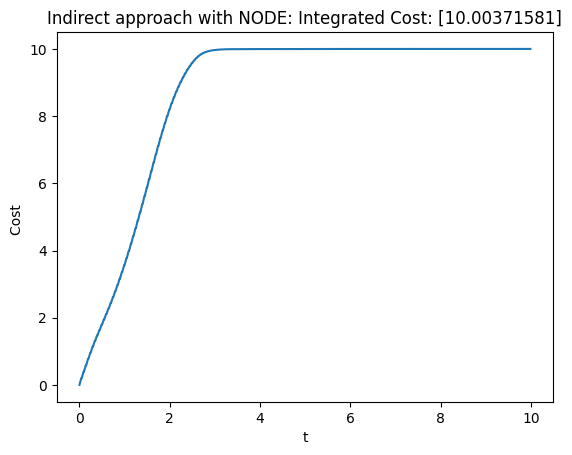

In [18]:
# run with ground truth as internal model
H=3
ts, ts_dense, X, Y, U, R = ensemble_indirect_mpc.simulate(
                        x0=env.get_initial_condition(subkey), 
                        ts=trial_ts,
                        Delta_t=env.Delta_t,
                        x_star=env.x_star,
                        dt0_internal=dt0_internal,
                        dt0_dense=dt0_dense,
                        H=H,
                        obs_noise=0.,
                        key=subkey,
                    )
key, subkey = jr.split(key)


pmp_ensemble_trial_cost = R[-1]
plt.plot(ts_dense, R)
plt.title(f'Indirect approach with NODE: Integrated Cost: {R[-1]}')
plt.ylabel('Cost ')
plt.xlabel('t')
plt.show()

### Mean Hamiltonian PMP

In [19]:
from ppc.control.trajectory_optimizers import EnsemblePMPForwardMeanHamiltonian
from ppc.control.mpc import ensembleDirectMPC, ensembleIndirectMPC
maxiter = 15
n_segments = 4
pmp_solver = EnsemblePMPForwardMeanHamiltonian(f=opt_ensemble_node.vectorfield,
                        D_sys=real_system.D_sys, 
                        D_control=real_system.D_control,
                        ensemble_size=ensemble_size,
                        n_segments=n_segments,
                        state_cost=env.state_cost,
                        termination_cost=env.termination_cost,
                        maxiter=maxiter, 
                        lb=env.lb*jnp.ones((n_controls, real_system.D_control)), 
                        ub=env.ub*jnp.ones((n_controls, real_system.D_control)),
                        )


ensemble_indirect_mpc = ensembleIndirectMPC(traj_optimizer=pmp_solver,
            real_system=real_system,
            internal_system=opt_ensemble_node,
            state_cost=env.state_cost,
            termination_cost=env.termination_cost,
            verbose=True,
            )

Initial optimization (iteration 0) not succesfull, continuing.
Initial optimization (iteration 1) not succesfull, continuing.
Initial optimization (iteration 2) not succesfull, continuing.
Initial optimization (iteration 3) not succesfull, continuing.
Initial optimization (iteration 4) not succesfull, continuing.
Initial optimization (iteration 5) not succesfull, continuing.
Initial optimization (iteration 6) not succesfull, continuing.
Initial optimization (iteration 7) not succesfull, continuing.
Initial optimization (iteration 8) not succesfull, continuing.
Initial optimization (iteration 9) not succesfull, continuing.
Initial optimization (iteration 10) not succesfull, continuing.
Initial optimization (iteration 11) not succesfull, continuing.
Initial optimization (iteration 12) not succesfull, continuing.
Initial optimization (iteration 13) not succesfull, continuing.
Initial optimization (iteration 14) not succesfull, continuing.
Initial optimization (iteration 15) not succesfull

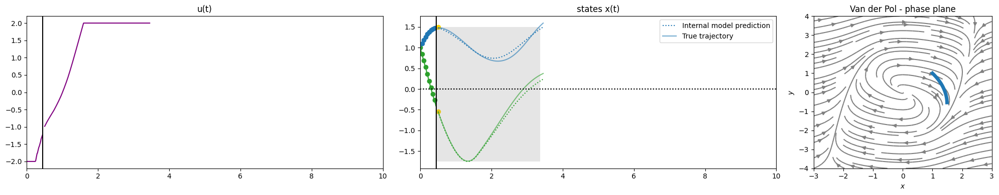

Traj. opt. times:  [(0.6247, 15), (0.528, 15), (0.5911, 15), (0.5944, 15), (0.649, 15), (0.5507, 15), (0.5869, 15), (0.6336, 15), (0.5424, 15), (0.586, 15)]


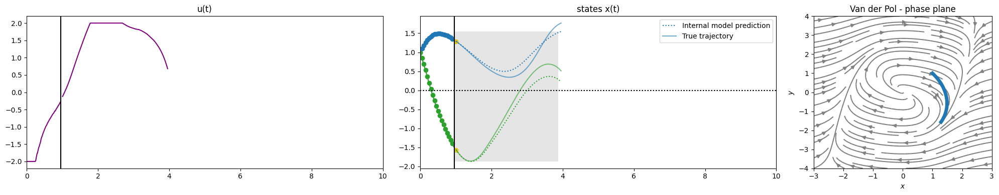

Traj. opt. times:  [(0.6614, 15), (0.723, 15), (0.7476, 15), (0.7305, 15), (0.5416, 15), (0.552, 15), (0.5253, 15), (0.5071, 15), (0.5185, 15), (0.5623, 15)]


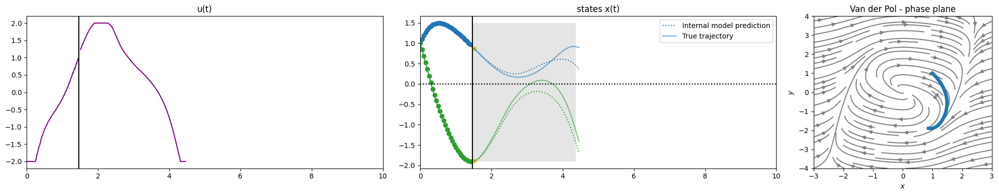

Traj. opt. times:  [(0.5353, 15), (0.5817, 15), (0.7149, 15), (0.5552, 15), (0.5343, 15), (0.448, 15), (0.6245, 15), (0.4439, 15), (0.5393, 15), (0.6285, 15)]


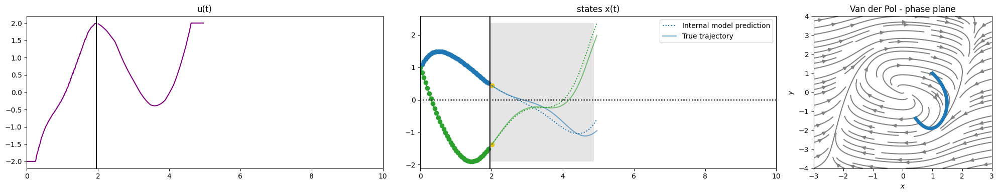

Traj. opt. times:  [(0.6074, 15), (0.5393, 15), (0.5463, 15), (0.7193, 15), (0.5485, 15), (0.5708, 15), (0.5439, 15), (0.5344, 15), (0.5408, 15), (0.5307, 15)]


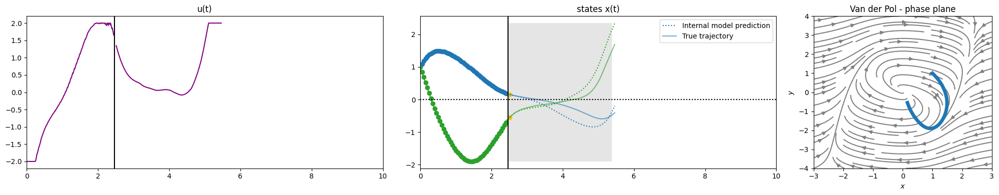

Traj. opt. times:  [(0.5684, 15), (0.5068, 15), (0.4967, 15), (0.5216, 15), (0.5219, 15), (0.5013, 15), (0.5238, 15), (0.628, 15), (0.5219, 15), (0.5819, 15)]


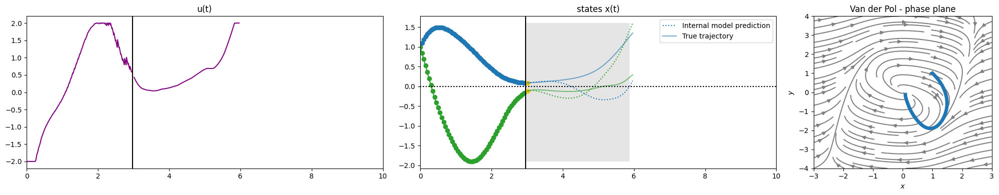

Traj. opt. times:  [(0.5536, 15), (0.5385, 15), (0.5937, 15), (0.5207, 15), (0.4811, 15), (0.4676, 15), (0.4718, 15), (0.554, 15), (0.4454, 15), (0.4382, 15)]


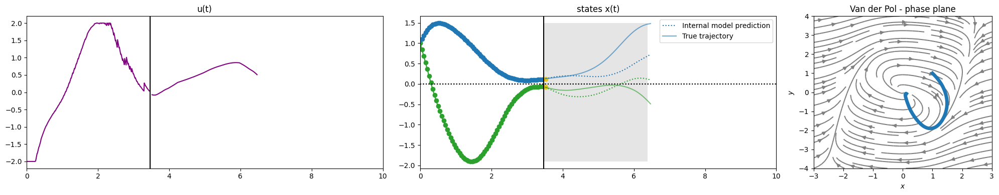

Traj. opt. times:  [(0.4763, 15), (0.5306, 15), (0.5298, 15), (0.5842, 15), (0.6064, 15), (0.5366, 15), (0.5165, 15), (0.5615, 15), (0.467, 15), (0.4376, 15)]


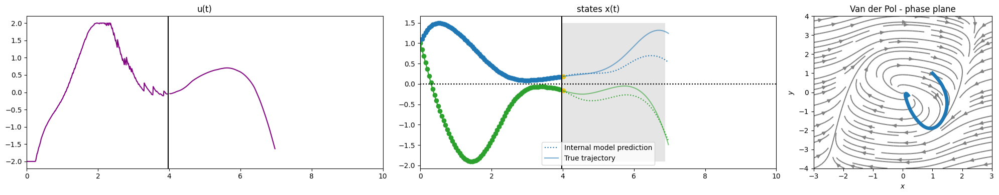

Traj. opt. times:  [(0.5379, 15), (0.6531, 15), (0.6056, 15), (0.5831, 15), (0.5316, 15), (0.5479, 15), (0.5591, 15), (0.5473, 15), (0.5233, 15), (0.5361, 15)]


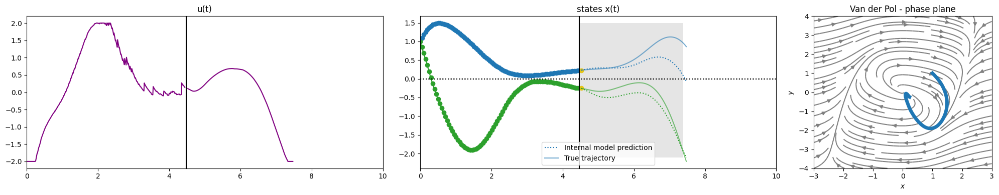

Traj. opt. times:  [(0.5827, 15), (0.601, 15), (0.6412, 15), (0.5478, 15), (0.545, 15), (0.5704, 15), (0.5781, 15), (0.5583, 15), (0.4413, 15), (0.4428, 15)]


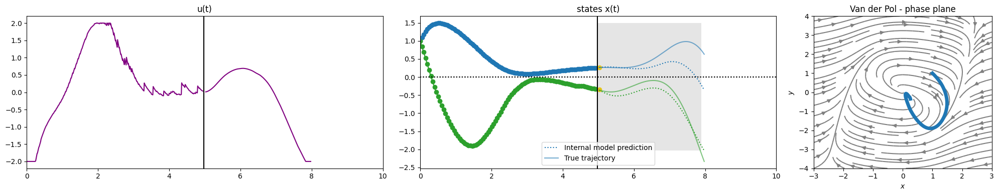

Traj. opt. times:  [(0.4864, 15), (0.7053, 15), (0.5951, 15), (0.6117, 15), (0.5567, 15), (0.5472, 15), (0.5499, 15), (0.5608, 15), (0.5708, 15), (0.4405, 15)]


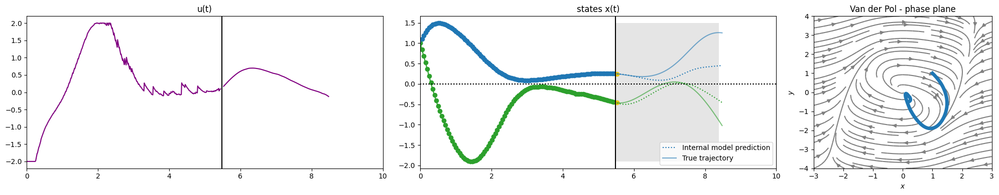

Traj. opt. times:  [(0.442, 15), (0.4354, 15), (0.4436, 15), (0.5632, 15), (0.6354, 15), (0.4081, 15), (0.4043, 15), (0.3841, 15), (0.485, 15), (0.4767, 15)]


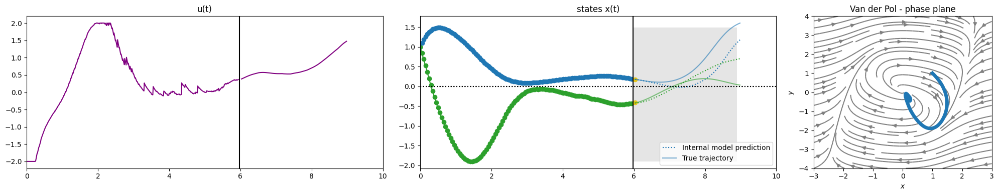

Traj. opt. times:  [(0.5356, 15), (0.5938, 15), (0.4551, 15), (0.5773, 15), (0.5356, 15), (0.5707, 15), (0.5168, 15), (0.4182, 15), (0.5493, 15), (0.4205, 15)]


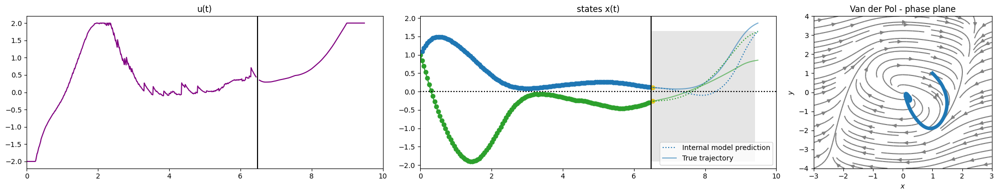

Traj. opt. times:  [(0.4938, 15), (0.4709, 15), (0.4295, 15), (0.4642, 15), (0.4743, 15), (0.415, 15), (0.4271, 15), (0.5194, 15), (0.4899, 15), (0.5536, 15)]


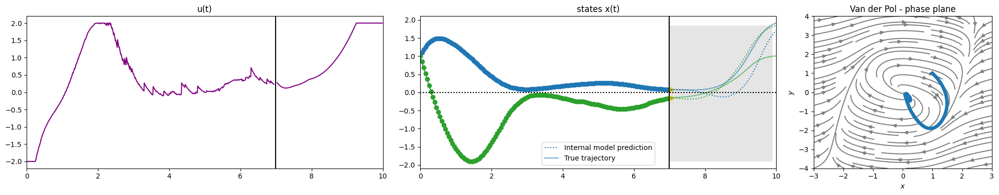

Traj. opt. times:  [(0.4201, 15), (0.438, 15), (0.3885, 15), (0.4412, 15), (0.4223, 15), (0.4547, 15), (0.4605, 15), (0.4584, 15), (0.5019, 15), (0.5105, 15)]


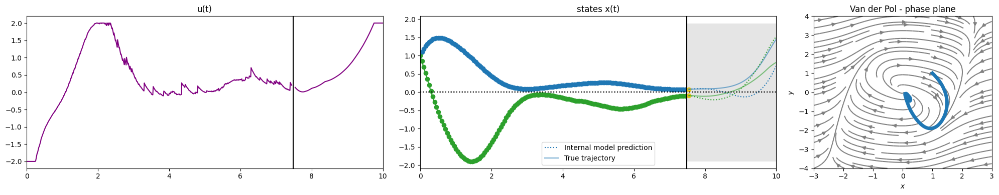

Traj. opt. times:  [(0.4617, 15), (0.4275, 15), (0.4536, 15), (0.5387, 15), (0.5809, 15), (0.6513, 15), (0.4433, 15), (0.5976, 15), (0.5093, 15), (0.5362, 15)]


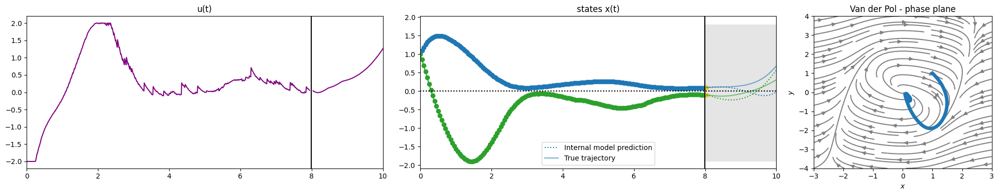

Traj. opt. times:  [(0.4978, 15), (0.4177, 15), (0.4462, 15), (0.6255, 15), (0.5215, 15), (0.4675, 15), (0.5226, 15), (0.4981, 15), (0.4187, 15), (0.3904, 15)]


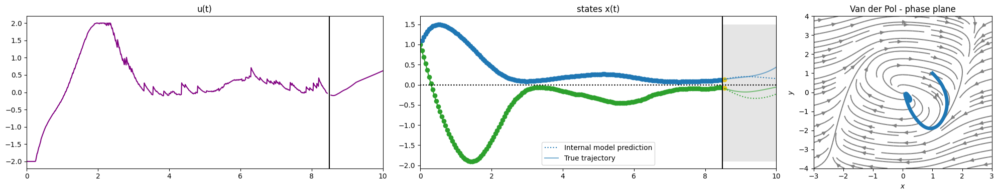

Traj. opt. times:  [(0.3846, 15), (0.4486, 15), (0.4383, 15), (0.5047, 15), (0.6366, 15), (0.5153, 15), (0.4104, 15), (0.4407, 15), (0.5192, 15), (0.4826, 15)]


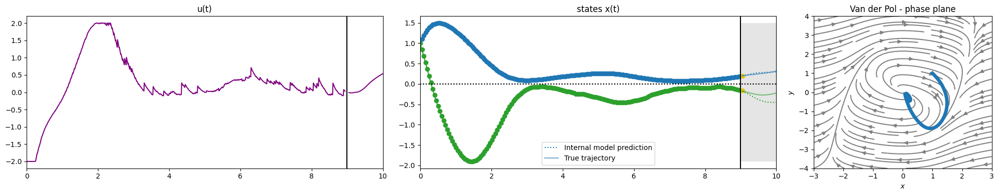

Traj. opt. times:  [(0.6079, 15), (0.4395, 15), (0.5192, 15), (0.559, 15), (0.6134, 15), (0.5639, 15), (0.5379, 15), (0.5334, 15), (0.5351, 15), (0.5241, 15)]


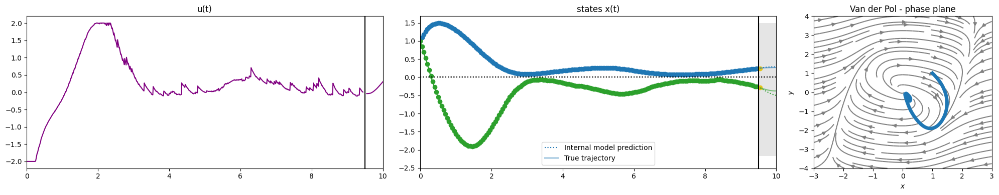

Traj. opt. times:  [(0.5583, 15), (0.5255, 15), (0.4263, 15), (0.4079, 15), (0.4885, 15), (0.4056, 15), (0.3969, 15), (0.3839, 15), (0.4803, 15), (0.5262, 15)]


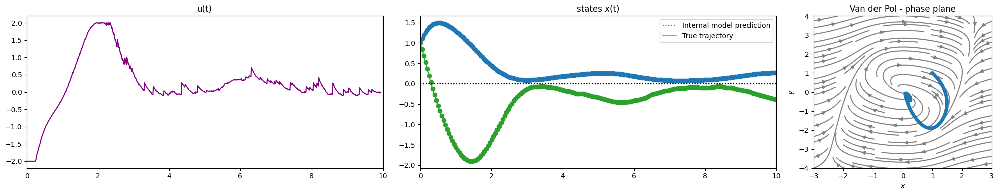

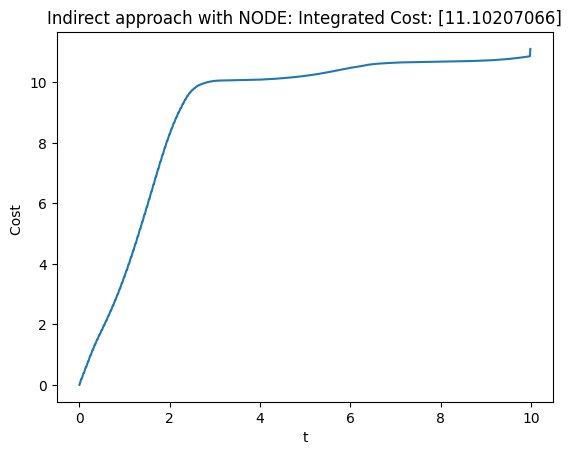

In [20]:
# run with ground truth as internal model
H=3
ts, ts_dense, X, Y, U, R = ensemble_indirect_mpc.simulate(
                        x0=env.get_initial_condition(subkey), 
                        ts=trial_ts,
                        Delta_t=env.Delta_t,
                        x_star=env.x_star,
                        dt0_internal=dt0_internal*2.5,
                        dt0_dense=dt0_dense,
                        H=H,
                        obs_noise=0.,
                        key=subkey,
                    )
key, subkey = jr.split(key)


pmp_ensemble_trial_cost_mean_hamiltonian = R[-1]
plt.plot(ts_dense, R)
plt.title(f'Indirect approach with NODE: Integrated Cost: {R[-1]}')
plt.ylabel('Cost ')
plt.xlabel('t')
plt.show()

## Compute mean objective with SQP

In [21]:
print('Seed: ', key)
print('PMP_ determinsitic cost: ', pmp_ensemble_trial_cost)
print('PMP_ determinsitic cost: ', pmp_ensemble_trial_cost_mean_hamiltonian)
print('CEM determinsitic cost: ', cem_ensemble_trial_cost)
print('SQP determinsitic cost: ', sqp_ensemble_trial_cost)
print('BFGS determinsitic cost: ', bfgs_ensemble_trial_cost)
print('Adam determinsitic cost: ', adam_ensemble_trial_cost)


Seed:  [3668826349 1724401712]
PMP_ determinsitic cost:  [10.00371581]
PMP_ determinsitic cost:  [11.10207066]
CEM determinsitic cost:  [20.73538157]
SQP determinsitic cost:  [13.62919362]
BFGS determinsitic cost:  [13.17319095]
Adam determinsitic cost:  [11.50200632]
